# PyTorch Model on Dummy Dataset (v6)

#### Chess Board Object Detection

#### CIS 520, Spring 2019

This notebook is written to run on [Google Colab](https://colab.research.google.com/notebook). 

----


In [1]:
# # Check out available CPU and GPU memory
!ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
!pip install gputil
!pip install psutil
!pip install humanize
import psutil
import humanize
import os
import GPUtil as GPU

def print_CPU_GPU_info(GPUs):
    process = psutil.Process(os.getpid())
    print(f"\nCPU \tRAM Free: {humanize.naturalsize(psutil.virtual_memory().available)}"
          f"    | Proc size: {humanize.naturalsize(process.memory_info().rss)}")
    if GPUs[0]: 
        for i,gpu in enumerate(GPUs):
            print(f"GPU {i} \tRAM Free: {gpu.memoryFree/1000:.3f} GB  "
                  f"| Used: {gpu.memoryUsed/1000:.3f} GB"
                  f"\t| Utilization: {gpu.memoryUtil*100:3.0f}% | "
                  f"Total Memory: {gpu.memoryTotal/1000:.3f} GB")
    else: print(f"Not on a GPU")


  Stored in directory: /root/.cache/pip/wheels/3d/77/07/80562de4bb0786e5ea186911a2c831fdd0018bda69beab71fd
Successfully built gputil


In [2]:
print_CPU_GPU_info(GPU.getGPUs())


CPU 	RAM Free: 12.9 GB    | Proc size: 117.7 MB
GPU 0 	RAM Free: 15.079 GB  | Used: 0.000 GB	| Utilization:   0% | Total Memory: 15.079 GB


In [3]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) { return false; }
// disable scrollable cells

<IPython.core.display.Javascript object>

In [0]:
# ! rm -rf pytorch_general
# ! rm -rf images
# ! rm -rf piece_images
# ! rm -rf chess-ray-vision
# ! rm -rf utils

In [5]:
! git clone https://github.com/samryan18/chess-ray-vision
! mv chess-ray-vision/src/* .
! mv chess-ray-vision/assets/* .


#NOTE this next line will download 2+ GB of data
#Do not run locally unless your comp can take that kinda heat
! git clone https://github.com/mukundv7/crvdataset 
! mkdir train_full
! mv crvdataset/chess-positions/train-full/* train_full/

Cloning into 'chess-ray-vision'...
remote: Enumerating objects: 239, done.
remote: Counting objects: 100% (239/239), done.
remote: Compressing objects: 100% (188/188), done.
remote: Total 239 (delta 102), reused 184 (delta 49), pack-reused 0
Receiving objects: 100% (239/239), 45.58 MiB | 48.41 MiB/s, done.
Resolving deltas: 100% (102/102), done.
Cloning into 'crvdataset'...
remote: Enumerating objects: 39509, done.
remote: Counting objects: 100% (39509/39509), done.
remote: Compressing objects: 100% (39378/39378), done.
remote: Total 39509 (delta 150), reused 39484 (delta 128), pack-reused 0
Receiving objects: 100% (39509/39509), 770.54 MiB | 38.09 MiB/s, done.
Resolving deltas: 100% (150/150), done.
Checking out files: 100% (39691/39691), done.


In [160]:
! rm -rf chess-ray-vision
! git clone https://github.com/samryan18/chess-ray-vision
! mv chess-ray-vision/preprocessing/real_images_tr/labeled .


Cloning into 'chess-ray-vision'...
remote: Enumerating objects: 9, done.
remote: Counting objects: 100% (9/9), done.
remote: Compressing objects: 100% (7/7), done.
remote: Total 286 (delta 3), reused 6 (delta 2), pack-reused 277
Receiving objects: 100% (286/286), 78.24 MiB | 50.26 MiB/s, done.
Resolving deltas: 100% (109/109), done.
mv: cannot move 'chess-ray-vision/preprocessing/real_images_tr/labeled' to './labeled': Directory not empty


In [174]:
import os
for fname in os.listdir('labeled'):
    print(fname)
    src =f'labeled/{fname}'
    dest = src.replace(':', "-")
    dest = dest.replace('3P5', '3P4')

    print(dest)
    os.rename(src, dest) 

rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR.jpeg
labeled/rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR.jpeg
r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R.jpeg
labeled/r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R.jpeg
rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R.jpeg
labeled/rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R.jpeg
rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR.jpeg
labeled/rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR.jpeg
r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R.jpeg
labeled/r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R.jpeg
rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR.jpeg
labeled/rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR.jpeg
rnbqkbnr-ppp1pppp-8-3p4-3P4-8-PPP1PPPP-RNBQKBNR.jpeg
labeled/rnbqkbnr-ppp1pppp-8-3p4-3P4-8-PPP1PPPP-RNBQKBNR.jpeg
rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR.jpeg
labeled/rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR.jpeg
rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR.jpeg
labeled/rnbqkbnr-ppp2ppp-4p

# Setup Stuff

In [162]:
# Pytorch Colab Setup
from os.path import exists
from wheel.pep425tags import get_abbr_impl, get_impl_ver, get_abi_tag
platform = '{}{}-{}'.format(get_abbr_impl(), get_impl_ver(), get_abi_tag())
cuda_output = !ldconfig -p|grep cudart.so|sed -e 's/.*\.\([0-9]*\)\.\([0-9]*\)$/cu\1\2/'
accelerator = cuda_output[0] if exists('/dev/nvidia0') else 'cpu'
!pip3 install https://download.pytorch.org/whl/cu100/torch-1.0.1-cp36-cp36m-linux_x86_64.whl
!pip3 install torchvision
  
import torch
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [0]:
# ## Required packages (Install in Colab)
# !pip install tensorflow
# !pip install scipy
# !pip install numpy
# !pip install Pillow
# !pip install image
# !pip install torchviz



In [164]:
%matplotlib inline

####################################################
# CODE IMPORTS

from pytorch_general.pytorch_helper import imshow
from pytorch_general.tensorboard_helper import Logger
from utils.data_loading_utils import (onehot_from_fen, fen_from_onehot, 
                                     fen_from_64, fen_from_filename, 
                                     process_image)
from utils.draw_chess_boards import DrawChessPosition

####################################################
# EXTERNAL IMPORTS

import torchvision
import torch 
import torch.nn as nn
import torchvision.datasets
import torchvision.transforms as transforms
import torch.nn.functional as F
import numpy as np;
from torch.utils.data import Dataset, DataLoader
import time, datetime
from tqdm import tqdm
from torchsummary import summary

from random import randint

from PIL import Image
from pathlib import Path
from random import shuffle
import os


import glob

import torch.optim as optim
device =torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [165]:
fen = '4kN1N-bbbbbbbb-QQ3B2-R1n1b3-8-8-ppqKbKbk-8'
class_prob = onehot_from_fen(fen)

print(f"Original: \t{fen}")
print(f"Reconstructed:  {fen_from_onehot(class_prob)}")

Original: 	4kN1N-bbbbbbbb-QQ3B2-R1n1b3-8-8-ppqKbKbk-8
Reconstructed:  4kN1N-bbbbbbbb-QQ3B2-R1n1b3-8-8-ppqKbKbk-8


In [0]:
class CustomChessDataset(Dataset):
    """Chess dataset"""

    def __init__(self, 
                 transform=None,
                 root='train_full',
                 train_size = None,
                 test_size = None,
                 downsample_size = 200,
                 train=True):

        self._train = train
        self.downsample_size = downsample_size
            
        self.root = root
        self.pathlist = list(Path(self.root).glob('**/*.jpeg'))
        self.n_files = len(self.pathlist)
        
        if train_size == None:
            train_size = len(os.listdir(root))
        if test_size == None:
            test_size = len(os.listdir(root))
        self.train_size = train_size
        self.test_size = test_size

        self.train = glob.glob(f"{root}/*.jpeg")
        self.test = glob.glob(f"{root}/*.jpeg")

        shuffle(self.train)
        shuffle(self.test)

        self.train = self.train[:self.train_size]
        self.test = self.test[:self.test_size]


    def __len__(self):
        return self.train_size

    def __getitem__(self, idx):
        img = self.train[idx]
        try:
            label = onehot_from_fen(fen_from_filename(img))
        except:
            print(img)
            raise
            

        img_as_img, original_img = process_image(img, 
                                                 downsample_size = self.downsample_size)

        return ((torch.from_numpy(img_as_img).float()), 
                label,
                original_img)

In [0]:
# BATCH_SIZE needs to be small ish bc bigger models will scale 
# memory usage exponentially
BATCH_SIZE=10
downsample_size=200
transform = transforms.Compose([transforms.Resize(downsample_size)])

train_dataset = CustomChessDataset(root='labeled/', train=True, 
                                   downsample_size=downsample_size)
test_dataset = CustomChessDataset(root='labeled/', train=False, 
                                  downsample_size=downsample_size)

# train_dataset = CustomChessDataset(root='train_full/', train=True, 
#                                    downsample_size=downsample_size)
# test_dataset = CustomChessDataset(root='train_full/', train=False, 
#                                   downsample_size=downsample_size)

train_loader = torch.utils.data.DataLoader(dataset=train_dataset,
                                           batch_size=BATCH_SIZE,
                                           shuffle=True)

test_loader = torch.utils.data.DataLoader(dataset=test_dataset,
                                          batch_size=BATCH_SIZE,
                                          shuffle=True)

In [0]:
def train_model(model: nn.Module, 
                log_dir: str,
                train_loader: torch.utils.data.DataLoader,
                criterion: torch.nn.modules.Module,
                optimizer: torch.optim.Optimizer,
                num_epochs: int=1,
                log_freq: int=25,
                print_guess=False,
                print_guess_freq=50) -> nn.Module:
    
    # Create Logging Directory for Tensorboard
    now = time.mktime(datetime.datetime.now().timetuple()) - 1550000000
    log_dir = f'{log_dir} ({now})/'
    logger = Logger(log_dir)
    print(f'Training model. Logging to: "{log_dir}"\n')

    model = model.to(device) # Send model to GPU if possible
    model.train() # Set model to training mode

    total_step = len(train_loader)
    for epoch in range(num_epochs):
        if print_guess: print(f'Epoch {epoch}')
        running_loss = 0
        
        # Tqdm will create a progress bar
        with tqdm(total=len(train_loader), 
                  desc=f'Epoch {epoch}', 
                  unit=' minibatches',
                  disable=(print_guess)) as pbar:
            
            # Iterate through minibatches
            for step, (images, labels, original_imgs) in enumerate(train_loader):
                if step==0:
                    images, labels = images.to(device), labels.long().to(device)

                    output = model(images).to(device)
                    _,class_labels = torch.max(labels,2) 
                    _, argmax = torch.max(output, 2)

                    accuracy = float((class_labels == 
                                      argmax.squeeze()).float().mean().cpu())

                    loss = criterion(output.reshape(10*64,13).float(),
                                     class_labels.reshape(10*64))

                    optimizer.zero_grad()
                    loss.backward()
                    optimizer.step()


                    running_loss += float(loss.item())

                    pbar.set_postfix(training_accuracy=accuracy, loss=loss.item(), refresh=True)
                    pbar.update(1)

                    if step % log_freq == 0:
                        overall_step = epoch*total_step + step

                        # 1. Log scalar values (scalar summary)
                        info = { 'loss': loss.item(), 'accuracy': accuracy }

                        for key, value in info.items():
                            logger.scalar_summary(key, value, overall_step)

                        # 2. Log values and gradients of the parameters
                        # (histogram summary)
                        for key, value in model.named_parameters():
                            key = key.replace('.', '/')
                            logger.histo_summary(key, 
                                                 value.data.cpu().numpy(), 
                                                 overall_step)
                            try:
                                logger.histo_summary(key+'/grad', 
                                                     value.grad.data.cpu().numpy(),
                                                     overall_step)
                            except (AttributeError):
                                # During transfer learning some of the variables 
                                # don't have grads
                                pass

                    if print_guess and step % print_guess_freq == 0:

                        overall_step = epoch*total_step + step
                        print(f"\n{60*'-'}\nBatch Number: {overall_step}")
                        print(f"Example training point:")
                        print(f"Actual: {fen_from_64(class_labels.cpu()[0])}")
                        print(f"Guess: {fen_from_64(argmax.cpu()[0])}")
                        print(f"Example Accuracy: {float((class_labels[0] == argmax[0]).float().mean().cpu())}")

                        renderer = DrawChessPosition(delimiter='-')
                        board_actual = renderer.draw(fen_from_64(class_labels.cpu()[0]))
                        board_guess = renderer.draw(fen_from_64(argmax.cpu()[0]))
                        renderer.show_side_by_side(board1= original_imgs[0],
                                                   board2=board_guess, 
                                                   board1_title='Actual',
                                                   board2_title='Prediction (Re'
                                                                'ndered to image)')
        print(f"{epoch}: Training loss: {running_loss/len(train_loader)}")
        print(f"{epoch}: Training accuracy: {accuracy}")
 
    return model



def test_model(model, criterion, test_loader) -> float:
    
    '''
    TODO: REWRITE THIS
    '''
    model = model.to(device)
    correct = 0
    total = 0
    accuracies = []
    losses = []
    total_step = len(test_loader)
    with torch.no_grad():
        for i in range(total_step):
            for  images, labels in test_loader:
                images, labels = images.to(device), labels.long().to(device)
                _,class_labels = torch.max(labels,1) 

                output = model(images).to(device)
                loss = criterion(output, class_labels)
                losses.append(float(loss.item()))


                # Compute accuracy
                _, argmax = torch.max(output, 1)
                accuracy = float((class_labels == argmax.squeeze()).float().mean().cpu())
                accuracies.append(accuracy)
                
    print(f'Accuracy of the network on test images: {np.average(accuracies)}')
    print(f'Avg. Loss of the network on test images: {np.average(losses)}')

    return np.average(accuracies)

# Models

In [0]:
class Flatten(nn.Module):
    def forward(self, input):
        return input.view(input.size(0), -1) 

class SimpleCNN(torch.nn.Module):
    def __init__(self, batch_size):
        super(SimpleCNN, self).__init__()
        self.name = 'SimpleCNN'
        self.batch_size=batch_size
        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, stride=1),
            nn.LeakyReLU(negative_slope=0.1))
        self.conv2 = nn.Sequential(
            nn.Conv2d(in_channels=32, out_channels=32, kernel_size=3, stride=1),
            nn.ReLU())
        self.conv3 = nn.Sequential(
            nn.Conv2d(in_channels=32, out_channels=32, kernel_size=3, stride=1),
            nn.ReLU())
        self.flatten = Flatten()
        self.fc1 = nn.Sequential(
            nn.Linear(32*19*19, 256),
            nn.ReLU(),
            nn.Dropout(p = 0.1))
        self.fc2 = nn.Sequential(
            nn.Linear(256, 13))

    def forward(self, x):
        x = x.reshape(self.batch_size*64,3,25,25)

        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        
        x = self.flatten(x)
        
        x = self.fc1(x)
        x = self.fc2(x)
#         print(f'xsize: {x.size()}')
        x = x.reshape(self.batch_size,64,13)

        return(x)
    
class BiggerCNN(torch.nn.Module):
    def __init__(self, batch_size):
        super(BiggerCNN, self).__init__()
        self.name = 'BiggerCNN'
        self.batch_size=batch_size
        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, stride=1),
            nn.LeakyReLU(negative_slope=0.1))
        self.conv2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=1),
            nn.ReLU())
        self.conv3 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=1),
            nn.ReLU())
        self.flatten = Flatten()
        self.fc1 = nn.Sequential(
            nn.Linear(64*19*19, 512),
            nn.ReLU(),
            nn.Dropout(p = 0.1))
        self.fc2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Dropout(p = 0.1))
        self.fc3 = nn.Sequential(
            nn.Linear(256, 13))

    def forward(self, x):
        x = x.reshape(self.batch_size*64,3,25,25)

        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        
        x = self.flatten(x)
        
        x = self.fc1(x)
        x = self.fc2(x)
        x = self.fc3(x)

#         print(f'xsize: {x.size()}')
        x = x.reshape(self.batch_size,64,13)

        return(x)
    
class BiggerCNN_No_Dropout(torch.nn.Module):
    def __init__(self, batch_size):
        super(BiggerCNN_No_Dropout, self).__init__()
        self.name = 'BiggerCNN_No_Dropout'
        self.batch_size=batch_size
        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, stride=1),
            nn.LeakyReLU(negative_slope=0.1))
        self.conv2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=1),
            nn.ReLU())
        self.conv3 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=1),
            nn.ReLU())
        self.flatten = Flatten()
        self.fc1 = nn.Sequential(
            nn.Linear(64*19*19, 512),
            nn.ReLU())
        self.fc2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.ReLU())
        self.fc3 = nn.Sequential(
            nn.Linear(256, 13))

    def forward(self, x):
        x = x.reshape(self.batch_size*64,3,25,25)

        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        
        x = self.flatten(x)
        
        x = self.fc1(x)
        x = self.fc2(x)
        x = self.fc3(x)

#         print(f'xsize: {x.size()}')
        x = x.reshape(self.batch_size,64,13)

        return(x)
    
    
# class MoreSkinnierLayersBiggerCNN(torch.nn.Module):
#     def __init__(self, batch_size):
#         super(MoreSkinnierLayersBiggerCNN, self).__init__()
#         self.name = 'MoreSkinnierLayersBiggerCNN'
#         self.batch_size=batch_size
#         self.conv1 = nn.Sequential(
#             nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, stride=1),
#             nn.LeakyReLU(negative_slope=0.1))
#         self.conv2 = nn.Sequential(
#             nn.Conv2d(in_channels=32, out_channels=16, kernel_size=3, stride=1),
#             nn.ReLU())
#         self.conv3 = nn.Sequential(
#             nn.Conv2d(in_channels=16, out_channels=16, kernel_size=3, stride=1),
#             nn.ReLU())
#         self.conv4 = nn.Sequential(
#             nn.Conv2d(in_channels=16, out_channels=16, kernel_size=3, stride=1),
#             nn.ReLU())
#         self.conv5 = nn.Sequential(
#             nn.Conv2d(in_channels=16, out_channels=16, kernel_size=3, stride=1),
#             nn.ReLU())
#         self.flatten = Flatten()
#         self.fc1 = nn.Sequential(
#             nn.Linear(640*2704, 512),
#             nn.ReLU(),
#             nn.Dropout(p = 0.1))
#         self.fc2 = nn.Sequential(
#             nn.Linear(512, 256),
#             nn.ReLU(),
#             nn.Dropout(p = 0.1))
#         self.fc3 = nn.Sequential(
#             nn.Linear(256, 13))

#     def forward(self, x):
#         x = x.reshape(self.batch_size*64,3,25,25)

#         x = self.conv1(x)
#         x = self.conv2(x)
#         x = self.conv3(x)
#         x = self.conv3(x)
#         x = self.conv4(x)
#         x = self.conv5(x)
        
#         x = self.flatten(x)
        
#         x = self.fc1(x)
#         x = self.fc2(x)
#         x = self.fc3(x)

# #         print(f'xsize: {x.size()}')
#         x = x.reshape(self.batch_size,64,13)

#         return(x)

    
# class BatchNormBiggerCNN(torch.nn.Module):
#     def __init__(self, batch_size):
#         super(BatchNormBiggerCNN, self).__init__()
#         self.name = 'BatchNormBiggerCNN'
#         self.batch_size=batch_size
#         self.conv1 = nn.Sequential(
#             nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, stride=1),
#             nn.BatchNorm2d(64),
#             nn.LeakyReLU(negative_slope=0.1),
#             nn.Dropout(p = 0.1))
#         self.conv2 = nn.Sequential(
#             nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=1),
#             nn.BatchNorm2d(64),
#             nn.ReLU(),
#             nn.Dropout(p = 0.1))
#         self.conv3 = nn.Sequential(
#             nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, stride=1),
#             nn.ReLU())
#         self.flatten = Flatten()
#         self.fc1 = nn.Sequential(
#             nn.Linear(64*19*19, 512),
#             nn.ReLU(),
#             nn.Dropout(p = 0.1))
#         self.fc2 = nn.Sequential(
#             nn.Linear(512, 256),
#             nn.ReLU(),
#             nn.Dropout(p = 0.1))
#         self.fc3 = nn.Sequential(
#             nn.Linear(256, 13))

#     def forward(self, x):
#         x = x.reshape(self.batch_size*64,3,25,25)

#         x = self.conv1(x)
#         x = self.conv2(x)
#         x = self.conv3(x)
        
#         x = self.flatten(x)
        
#         x = self.fc1(x)
#         x = self.fc2(x)
#         x = self.fc3(x)

# #         print(f'xsize: {x.size()}')
#         x = x.reshape(self.batch_size,64,13)

#         return(x)

In [0]:
rm -rf logs

# Run it...

In [213]:
LOG_DIR = './logs'
get_ipython().system_raw(
    'tensorboard --logdir {} --host 0.0.0.0 --port 6006 &'
    .format(LOG_DIR)
)

!if [ -f ngrok ] ; then echo "Ngrok already installed" ; else wget https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip > /dev/null 2>&1 && unzip ngrok-stable-linux-amd64.zip > /dev/null 2>&1 ; fi

get_ipython().system_raw('./ngrok http 6006 &')

! curl -s http://localhost:4040/api/tunnels | python3 -c \
    "import sys, json; print('Tensorboard Link: ' +str(json.load(sys.stdin)['tunnels'][0]['public_url']))"

Ngrok already installed
Tensorboard Link: http://f7858814.ngrok.io


Training model. Logging to: "./logs/BiggerCNN_No_Dropout_lr0.001 (5628888.0)/"

Epoch 0


/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "



------------------------------------------------------------
Batch Number: 0
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: qqqqqqqq-qqqqqqqq-qqqqqqqq-qqqqqqqq-qqqqqqqq-qqqqqqqq-qqqqqqqq-qqqqqqqq
Example Accuracy: 0.015625


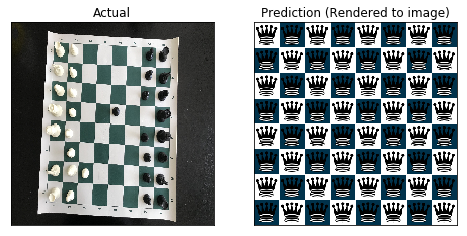

0: Training loss: 1.2864105701446533
0: Training accuracy: 0.015625
Epoch 1

------------------------------------------------------------
Batch Number: 2
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.5


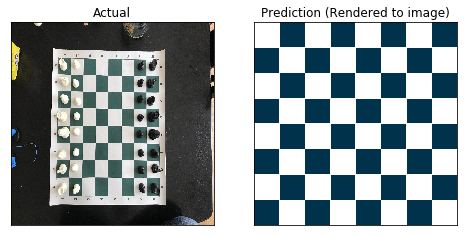

1: Training loss: 0.9879795908927917
1: Training accuracy: 0.5015625357627869
Epoch 2

------------------------------------------------------------
Batch Number: 4
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.5


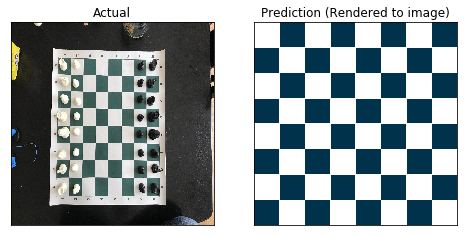

2: Training loss: 1.5439813137054443
2: Training accuracy: 0.503125011920929
Epoch 3

------------------------------------------------------------
Batch Number: 6
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.5


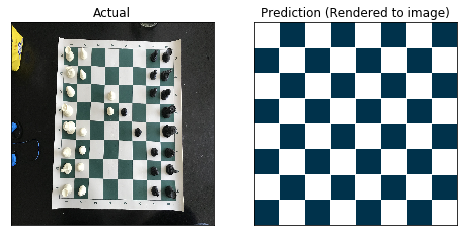

3: Training loss: 0.8872491121292114
3: Training accuracy: 0.503125011920929
Epoch 4

------------------------------------------------------------
Batch Number: 8
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: pppppppp-pppppppp-pppppppp-pppppppp-pppppppp-pppppppp-pppppppp-pppppppp
Example Accuracy: 0.125


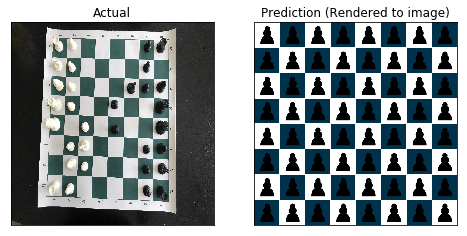

4: Training loss: 0.9881340861320496
4: Training accuracy: 0.125
Epoch 5

------------------------------------------------------------
Batch Number: 10
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: pppppppp-pppppppp-pppppppp-pppppppp-pppppppp-pppppppp-pppppppp-pppppppp
Example Accuracy: 0.125


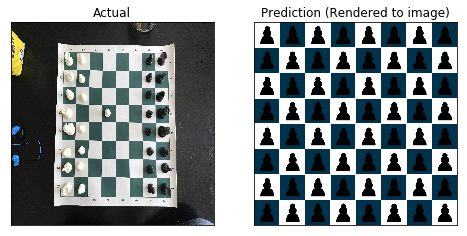

5: Training loss: 1.047248125076294
5: Training accuracy: 0.125
Epoch 6

------------------------------------------------------------
Batch Number: 12
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: pppppppp-pppppppp-pppppppp-pppppppp-pppppppp-pppppppp-pppppppp-pppppppp
Example Accuracy: 0.125


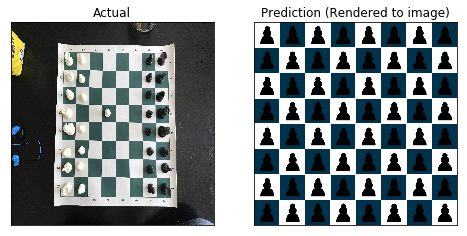

6: Training loss: 1.0271689891815186
6: Training accuracy: 0.125
Epoch 7

------------------------------------------------------------
Batch Number: 14
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: 8-2ppp3-2ppp3-2pppp2-2pp4-2p5-2pppp2-8
Example Accuracy: 0.375


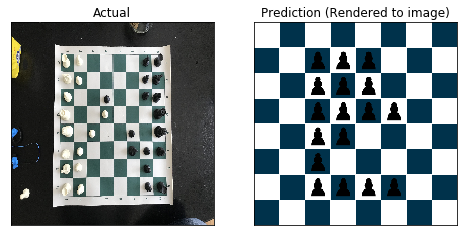

7: Training loss: 0.9632613062858582
7: Training accuracy: 0.42656251788139343
Epoch 8

------------------------------------------------------------
Batch Number: 16
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.5


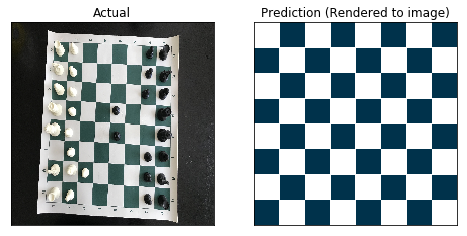

8: Training loss: 0.88038569688797
8: Training accuracy: 0.5015625357627869
Epoch 9

------------------------------------------------------------
Batch Number: 18
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.5


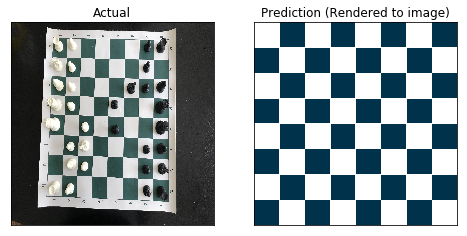

9: Training loss: 0.851983904838562
9: Training accuracy: 0.5015625357627869
Epoch 10

------------------------------------------------------------
Batch Number: 20
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.5


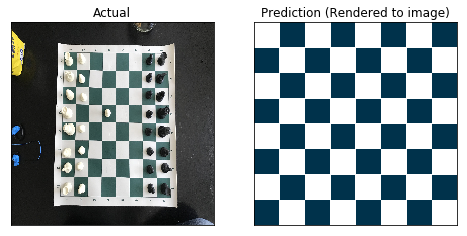

10: Training loss: 0.9065958857536316
10: Training accuracy: 0.503125011920929
Epoch 11

------------------------------------------------------------
Batch Number: 22
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.5


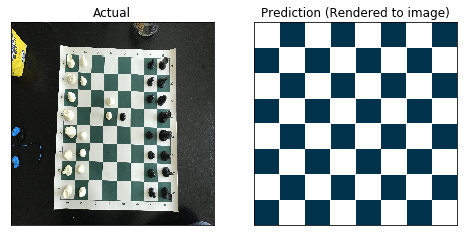

11: Training loss: 0.8570550680160522
11: Training accuracy: 0.5015625357627869
Epoch 12

------------------------------------------------------------
Batch Number: 24
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.5


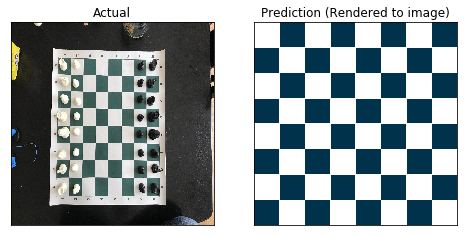

12: Training loss: 0.8199983835220337
12: Training accuracy: 0.503125011920929
Epoch 13

------------------------------------------------------------
Batch Number: 26
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.515625


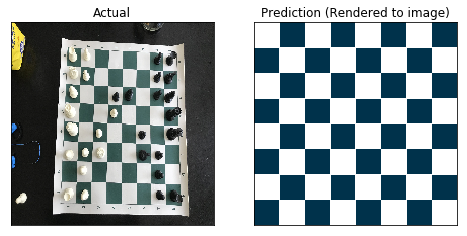

13: Training loss: 0.8432989120483398
13: Training accuracy: 0.503125011920929
Epoch 14

------------------------------------------------------------
Batch Number: 28
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.515625


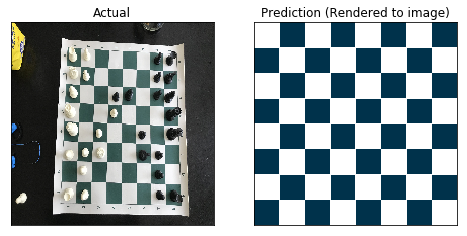

14: Training loss: 0.8393586277961731
14: Training accuracy: 0.5015625357627869
Epoch 15

------------------------------------------------------------
Batch Number: 30
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.515625


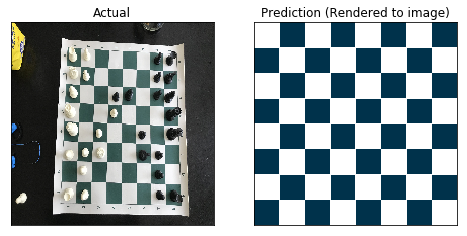

15: Training loss: 0.8147884607315063
15: Training accuracy: 0.503125011920929
Epoch 16

------------------------------------------------------------
Batch Number: 32
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.5


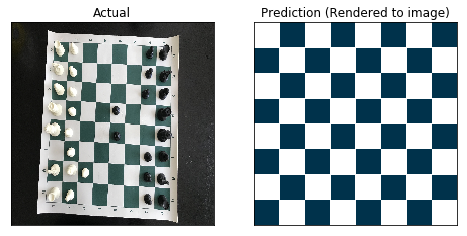

16: Training loss: 0.797131359577179
16: Training accuracy: 0.503125011920929
Epoch 17

------------------------------------------------------------
Batch Number: 34
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.515625


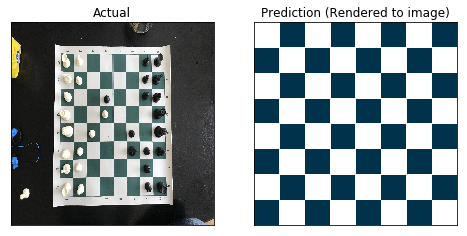

17: Training loss: 0.7829143404960632
17: Training accuracy: 0.5062500238418579
Epoch 18

------------------------------------------------------------
Batch Number: 36
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.515625


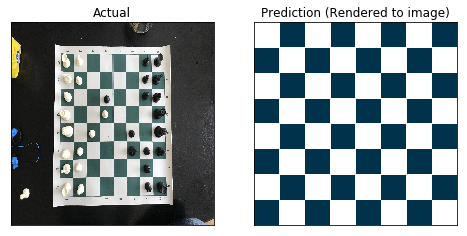

18: Training loss: 0.7802644968032837
18: Training accuracy: 0.512499988079071
Epoch 19

------------------------------------------------------------
Batch Number: 38
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.5


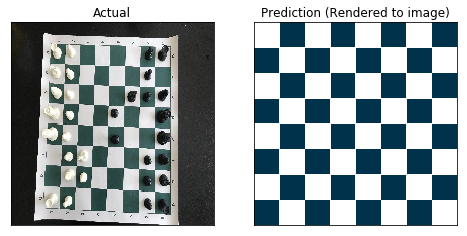

19: Training loss: 0.780807614326477
19: Training accuracy: 0.510937511920929
Epoch 20

------------------------------------------------------------
Batch Number: 40
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: 8-8-8-8-8-8-8-8
Example Accuracy: 0.5


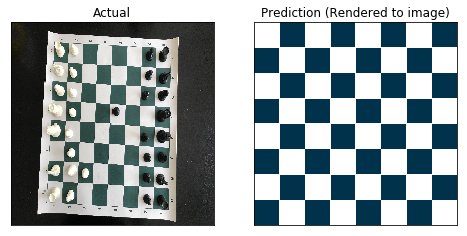

20: Training loss: 0.769623875617981
20: Training accuracy: 0.512499988079071
Epoch 21

------------------------------------------------------------
Batch Number: 42
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: 8-8-8-8-8-8-8-1BBB4
Example Accuracy: 0.515625


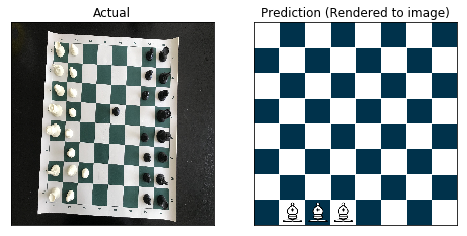

21: Training loss: 0.7551933526992798
21: Training accuracy: 0.5218750238418579
Epoch 22

------------------------------------------------------------
Batch Number: 44
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-2BBBBB1
Example Accuracy: 0.53125


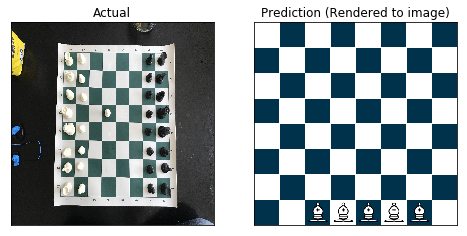

22: Training loss: 0.7368412017822266
22: Training accuracy: 0.5234375
Epoch 23

------------------------------------------------------------
Batch Number: 46
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-2BBBBB1
Example Accuracy: 0.53125


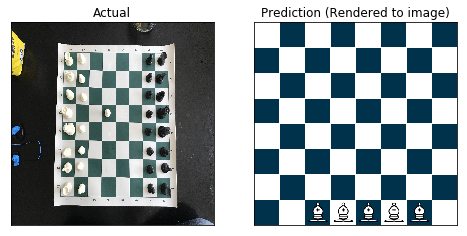

23: Training loss: 0.7245407104492188
23: Training accuracy: 0.5250000357627869
Epoch 24

------------------------------------------------------------
Batch Number: 48
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: 8-8-8-8-8-8-8-1B6
Example Accuracy: 0.5


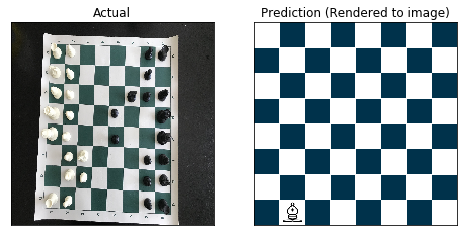

24: Training loss: 0.7200609445571899
24: Training accuracy: 0.518750011920929
Epoch 25

------------------------------------------------------------
Batch Number: 50
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-1BBBBB2
Example Accuracy: 0.546875


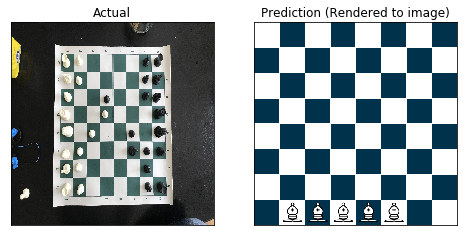

25: Training loss: 0.713962197303772
25: Training accuracy: 0.5171875357627869
Epoch 26

------------------------------------------------------------
Batch Number: 52
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: 8-8-8-8-8-8-8-1BB5
Example Accuracy: 0.515625


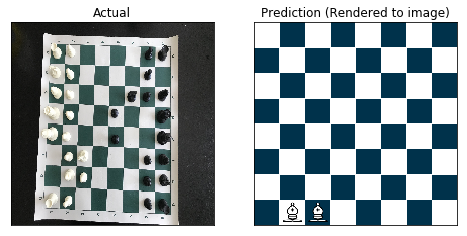

26: Training loss: 0.6949406862258911
26: Training accuracy: 0.520312488079071
Epoch 27

------------------------------------------------------------
Batch Number: 54
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: 4bb2-8-8-8-8-8-8-1BBBBB2
Example Accuracy: 0.515625


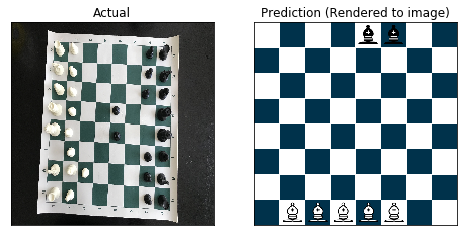

27: Training loss: 0.6959921717643738
27: Training accuracy: 0.53125
Epoch 28

------------------------------------------------------------
Batch Number: 56
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-3P4-8-PPP1PPPP-RNBQKBNR
Guess: 8-8-8-8-8-8-8-1BBBBBB1
Example Accuracy: 0.53125


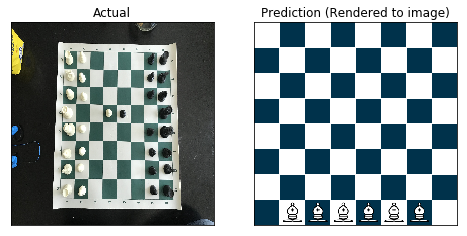

28: Training loss: 0.6973375082015991
28: Training accuracy: 0.528124988079071
Epoch 29

------------------------------------------------------------
Batch Number: 58
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: 2bbbb2-8-8-8-8-8-8-1QQQNN2
Example Accuracy: 0.53125


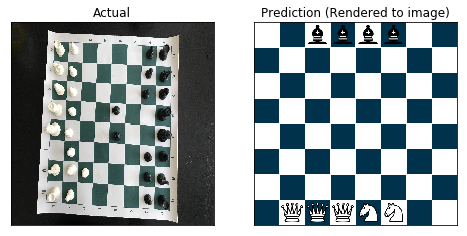

29: Training loss: 0.6711008548736572
29: Training accuracy: 0.5328125357627869
Epoch 30

------------------------------------------------------------
Batch Number: 60
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: b7-8-8-8-8-8-8-1NQQQQQ1
Example Accuracy: 0.53125


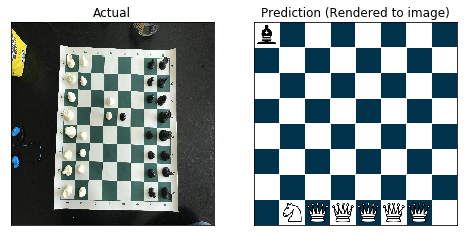

30: Training loss: 0.6742289066314697
30: Training accuracy: 0.535937488079071
Epoch 31

------------------------------------------------------------
Batch Number: 62
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: 8-8-8-8-8-8-b7-1NQQQQ1b
Example Accuracy: 0.546875


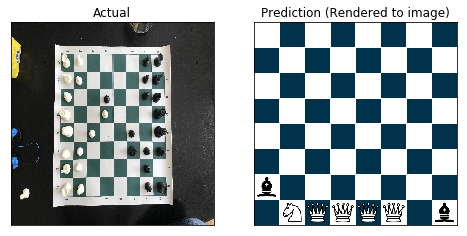

31: Training loss: 0.6621378660202026
31: Training accuracy: 0.5390625
Epoch 32

------------------------------------------------------------
Batch Number: 64
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: 2bbb3-8-8-8-8-8-b7-2QQQNN1
Example Accuracy: 0.53125


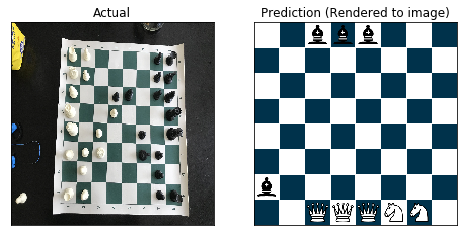

32: Training loss: 0.6427320241928101
32: Training accuracy: 0.535937488079071
Epoch 33

------------------------------------------------------------
Batch Number: 66
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: 2bbb3-8-8-8-8-8-b7-2BBBBN1
Example Accuracy: 0.546875


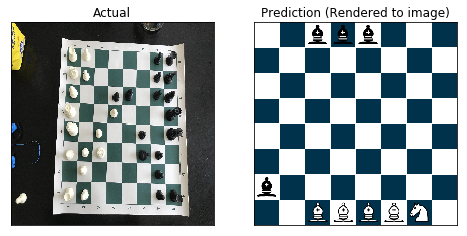

33: Training loss: 0.6348850727081299
33: Training accuracy: 0.546875
Epoch 34

------------------------------------------------------------
Batch Number: 68
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: 1bbbbbb1-8-8-8-8-8-8-1BBBBN2
Example Accuracy: 0.53125


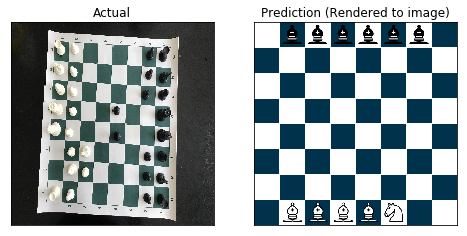

34: Training loss: 0.6398507356643677
34: Training accuracy: 0.543749988079071
Epoch 35

------------------------------------------------------------
Batch Number: 70
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: 2bbbbb1-8-8-8-8-8-8-1NBBBBB1
Example Accuracy: 0.578125


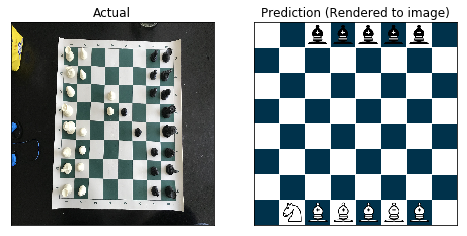

35: Training loss: 0.6523580551147461
35: Training accuracy: 0.5328125357627869
Epoch 36

------------------------------------------------------------
Batch Number: 72
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: 1bbbbbb1-8-8-3p4-8-8-8-1BBBBN2
Example Accuracy: 0.546875


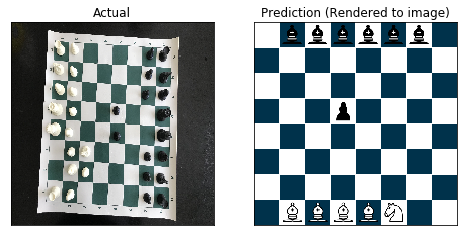

36: Training loss: 0.6454290151596069
36: Training accuracy: 0.551562488079071
Epoch 37

------------------------------------------------------------
Batch Number: 74
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR
Guess: 8-p7-8-8-8-8-8-1NBBBB1b
Example Accuracy: 0.5625


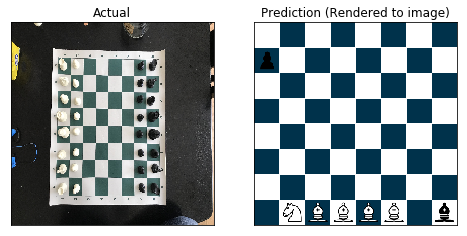

37: Training loss: 0.6385294198989868
37: Training accuracy: 0.543749988079071
Epoch 38

------------------------------------------------------------
Batch Number: 76
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: 1bbbbbn1-8-8-8-8-8-8-1N6
Example Accuracy: 0.546875


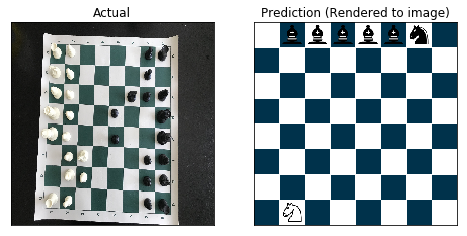

38: Training loss: 0.6184276342391968
38: Training accuracy: 0.5546875
Epoch 39

------------------------------------------------------------
Batch Number: 78
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: 1nqqqqq1-8-8-8-8-8-8-1QQQBN2
Example Accuracy: 0.53125


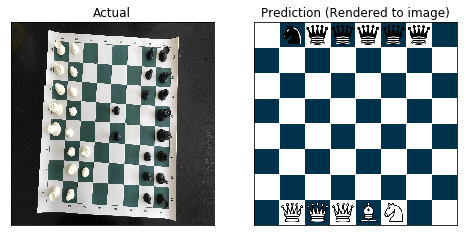

39: Training loss: 0.6114977598190308
39: Training accuracy: 0.543749988079071
Epoch 40

------------------------------------------------------------
Batch Number: 80
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR
Guess: 8-p7-8-8-8-8-8-1NBBBB1n
Example Accuracy: 0.5625


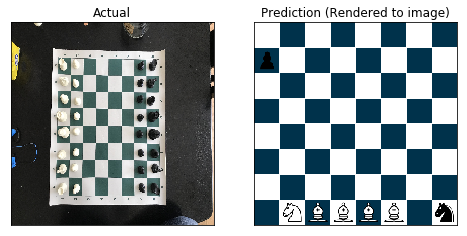

40: Training loss: 0.6232399344444275
40: Training accuracy: 0.543749988079071
Epoch 41

------------------------------------------------------------
Batch Number: 82
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: 1nqqqkq1-8-8-8-8-8-8-1QQQNN2
Example Accuracy: 0.53125


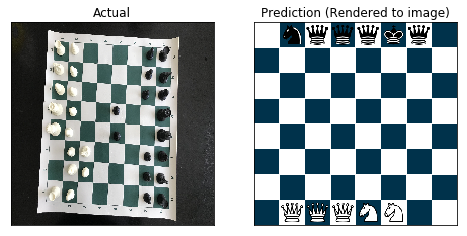

41: Training loss: 0.611992359161377
41: Training accuracy: 0.5390625
Epoch 42

------------------------------------------------------------
Batch Number: 84
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: 2kkkkn1-p7-8-8-8-8-8-1NQQQQB1
Example Accuracy: 0.578125


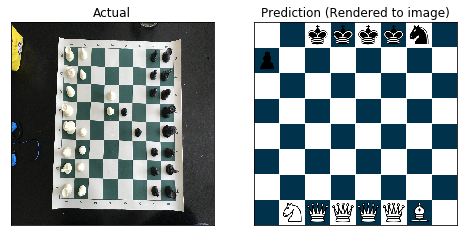

42: Training loss: 0.6010312438011169
42: Training accuracy: 0.551562488079071
Epoch 43

------------------------------------------------------------
Batch Number: 86
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: r2r4-p5p1-6p1-6p1-8-6p1-n7-1NBBBB1b
Example Accuracy: 0.5625


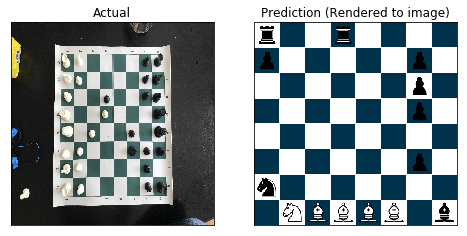

43: Training loss: 0.5729255676269531
43: Training accuracy: 0.567187488079071
Epoch 44

------------------------------------------------------------
Batch Number: 88
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: 1bbbbbn1-8-8-8-8-8-8-1N6
Example Accuracy: 0.546875


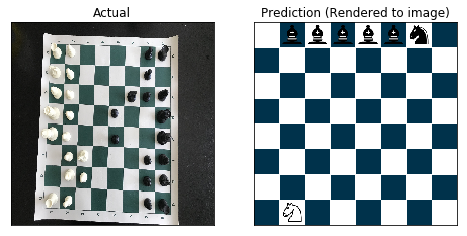

44: Training loss: 0.5760586857795715
44: Training accuracy: 0.5703125
Epoch 45

------------------------------------------------------------
Batch Number: 90
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: 1nbbbbb1-8-8-3p4-8-8-5n2-1BBBBN2
Example Accuracy: 0.5625


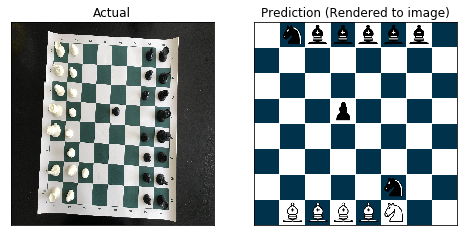

45: Training loss: 0.568852424621582
45: Training accuracy: 0.573437511920929
Epoch 46

------------------------------------------------------------
Batch Number: 92
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: r1RR4-4pp2-8-8-8-8-8-1NBBBBB1
Example Accuracy: 0.59375


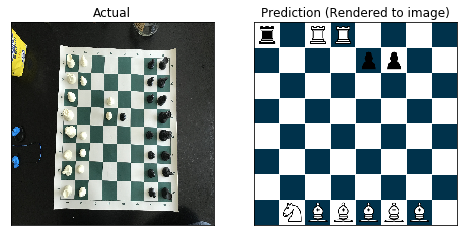

46: Training loss: 0.5321999788284302
46: Training accuracy: 0.59375
Epoch 47

------------------------------------------------------------
Batch Number: 94
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbbbbr1-p5p1-8-8-8-8-8-1NBBBBN1
Example Accuracy: 0.65625


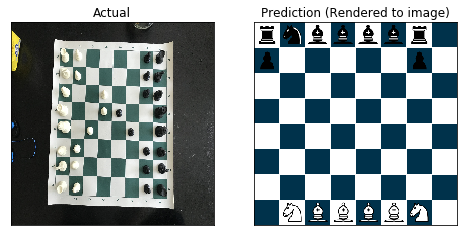

47: Training loss: 0.564275860786438
47: Training accuracy: 0.5859375
Epoch 48

------------------------------------------------------------
Batch Number: 96
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR
Guess: R1RR4-p1p2p1r-3p4-8-8-8-5P2-RNBBBB1b
Example Accuracy: 0.609375


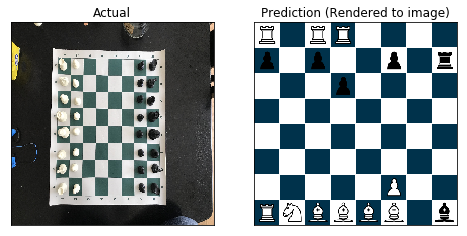

48: Training loss: 0.5483080744743347
48: Training accuracy: 0.5921875238418579
Epoch 49

------------------------------------------------------------
Batch Number: 98
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: R1bbbb2-8-8-8-5n2-8-8-RBQQQBNR
Example Accuracy: 0.53125


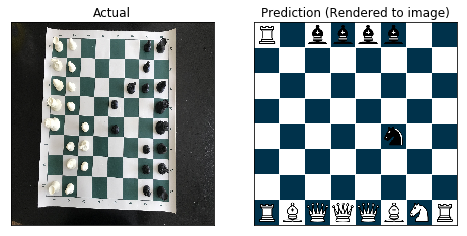

49: Training loss: 0.5323098301887512
49: Training accuracy: 0.6031250357627869
Epoch 50

------------------------------------------------------------
Batch Number: 100
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rRbbb1n1-p3pp2-8-8-8-8-8-1NBBBBNn
Example Accuracy: 0.65625


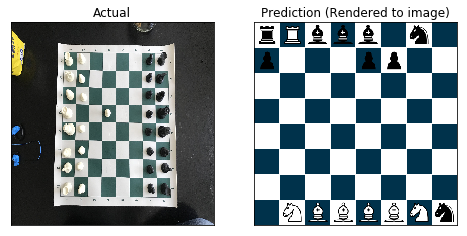

50: Training loss: 0.5192039012908936
50: Training accuracy: 0.6265625357627869
Epoch 51

------------------------------------------------------------
Batch Number: 102
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rRRR4-p4pp1-8-8-2p5-8-n7-1NBBBB1b
Example Accuracy: 0.640625


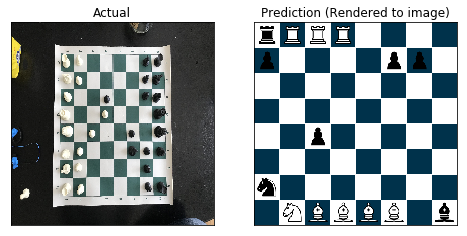

51: Training loss: 0.5428808927536011
51: Training accuracy: 0.6156250238418579
Epoch 52

------------------------------------------------------------
Batch Number: 104
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: Rnqqqqn1-7r-8-8-8-8-1P2Pn2-1BBQK2R
Example Accuracy: 0.640625


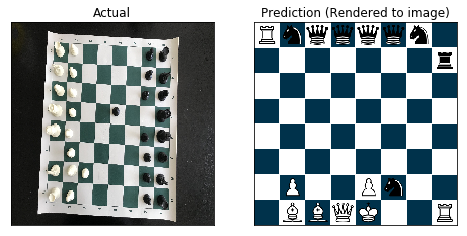

52: Training loss: 0.5085207223892212
52: Training accuracy: 0.620312511920929
Epoch 53

------------------------------------------------------------
Batch Number: 106
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rRbbkkn1-p3pp2-8-8-8-8-8-1NBBBBN1
Example Accuracy: 0.640625


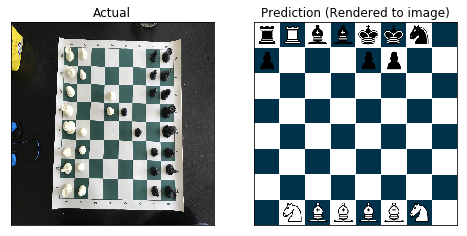

53: Training loss: 0.5265697240829468
53: Training accuracy: 0.6187500357627869
Epoch 54

------------------------------------------------------------
Batch Number: 108
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: Rnbbbbn1-1p3p2-8-3p4-8-8-1P2PnB1-1BBQK2R
Example Accuracy: 0.71875


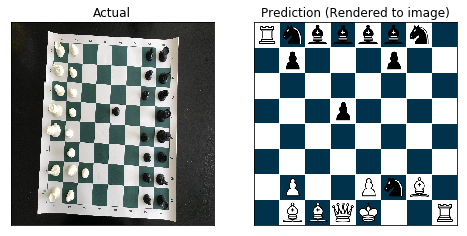

54: Training loss: 0.5232729911804199
54: Training accuracy: 0.635937511920929
Epoch 55

------------------------------------------------------------
Batch Number: 110
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: Rnbbbbn1-4P2R-8-3p4-8-1P6-1P2PPB1-1NQQK2R
Example Accuracy: 0.671875


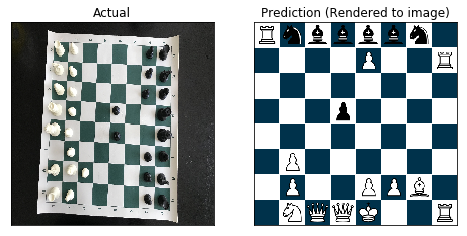

55: Training loss: 0.48106613755226135
55: Training accuracy: 0.637499988079071
Epoch 56

------------------------------------------------------------
Batch Number: 112
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rRbbbbn1-p7-8-8-8-8-8-RNBBBBN1
Example Accuracy: 0.65625


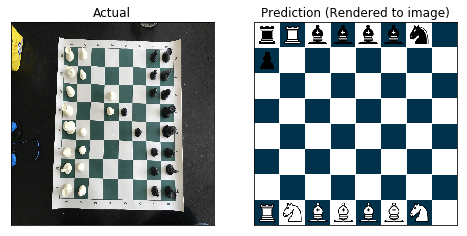

56: Training loss: 0.4670979082584381
56: Training accuracy: 0.6421875357627869
Epoch 57

------------------------------------------------------------
Batch Number: 114
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: Rnbbbbn1-1pp2p1r-1p6-3p4-8-8-3pPPB1-1BBQK1pR
Example Accuracy: 0.71875


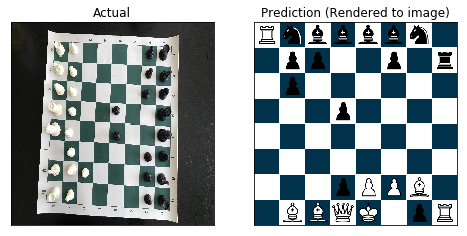

57: Training loss: 0.48549166321754456
57: Training accuracy: 0.6500000357627869
Epoch 58

------------------------------------------------------------
Batch Number: 116
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: Rnbbbbn1-3PP3-8-3p4-8-1P6-1P2PPB1-1NNQK2R
Example Accuracy: 0.65625


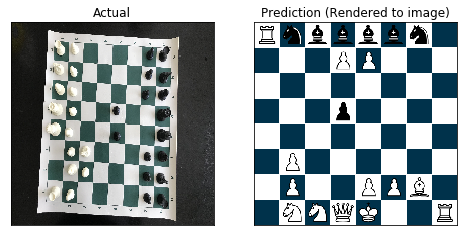

58: Training loss: 0.5171767473220825
58: Training accuracy: 0.621874988079071
Epoch 59

------------------------------------------------------------
Batch Number: 118
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbbbbnr-p1p2ppR-8-8-2Pp4-8-8-RNBQQQNR
Example Accuracy: 0.765625


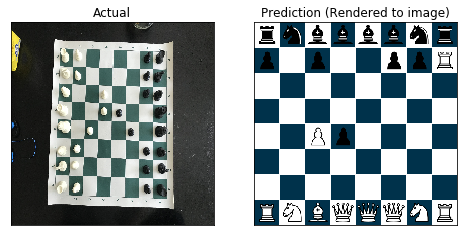

59: Training loss: 0.4619413912296295
59: Training accuracy: 0.6875
Epoch 60

------------------------------------------------------------
Batch Number: 120
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR
Guess: rnkkkbr1-p1p2pp1-8-8-3p4-8-5p2-1NBBBBN1
Example Accuracy: 0.6875


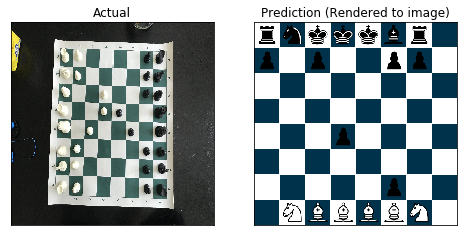

60: Training loss: 0.4588920474052429
60: Training accuracy: 0.6734375357627869
Epoch 61

------------------------------------------------------------
Batch Number: 122
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: Rnbqqbn1-1pp4r-8-3p4-8-8-4PPB1-1NBKK2R
Example Accuracy: 0.734375


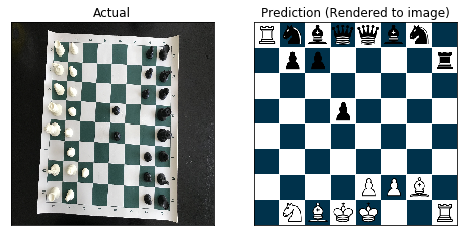

61: Training loss: 0.4317252039909363
61: Training accuracy: 0.690625011920929
Epoch 62

------------------------------------------------------------
Batch Number: 124
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: Rnbbbbn1-RppPPp1r-8-3p4-8-1PP5-1P2PPB1-RNBQK2R
Example Accuracy: 0.71875


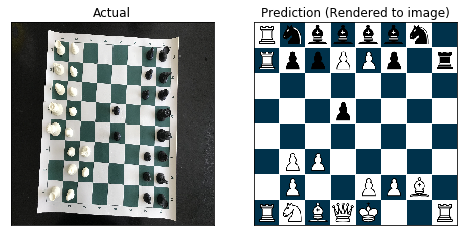

62: Training loss: 0.47009509801864624
62: Training accuracy: 0.676562488079071
Epoch 63

------------------------------------------------------------
Batch Number: 126
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: Rnbbbbn1-1pp5-8-3p4-8-8-1P2PPB1-1NBQK2R
Example Accuracy: 0.75


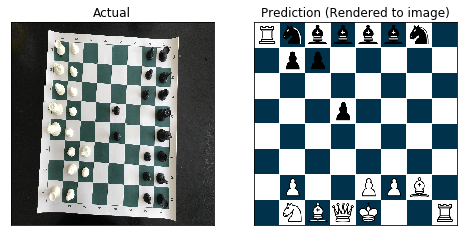

63: Training loss: 0.45850640535354614
63: Training accuracy: 0.6703125238418579
Epoch 64

------------------------------------------------------------
Batch Number: 128
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: Rnbbbbn1-1pp2pp1-1p6-3p4-8-8-3p1PB1-1NBQK1BR
Example Accuracy: 0.71875


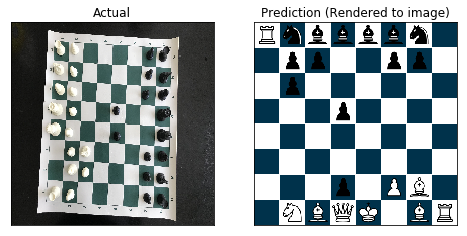

64: Training loss: 0.45593661069869995
64: Training accuracy: 0.659375011920929
Epoch 65

------------------------------------------------------------
Batch Number: 130
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rRbbb1n1-p3pppr-8-8-8-8-R3PP2-RNBQKQNn
Example Accuracy: 0.734375


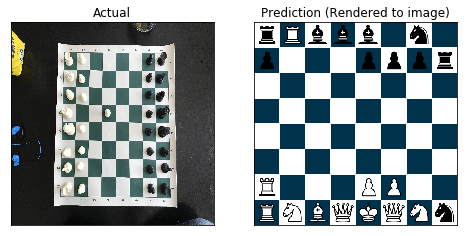

65: Training loss: 0.4462367594242096
65: Training accuracy: 0.667187511920929
Epoch 66

------------------------------------------------------------
Batch Number: 132
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rRbbb1nr-p3pp1r-8-8-2PPP3-8-RPP1PPP1-RNBKKKNn
Example Accuracy: 0.75


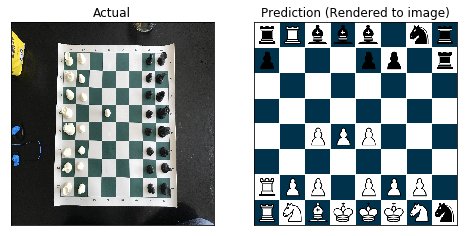

66: Training loss: 0.3980274200439453
66: Training accuracy: 0.699999988079071
Epoch 67

------------------------------------------------------------
Batch Number: 134
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rRqqb1P1-p1P1ppp1-8-8-2PPP3-2P5-RPP1PPP1-RNBBKKNn
Example Accuracy: 0.71875


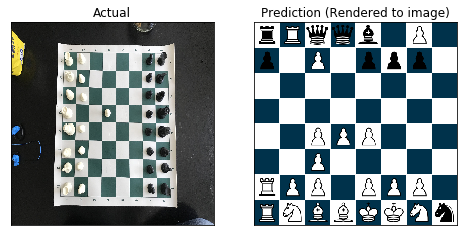

67: Training loss: 0.3948894441127777
67: Training accuracy: 0.7015625238418579
Epoch 68

------------------------------------------------------------
Batch Number: 136
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnkkkkn1-pp3pp1-8-3p4-8-8-5PP1-RNBQKKN1
Example Accuracy: 0.765625


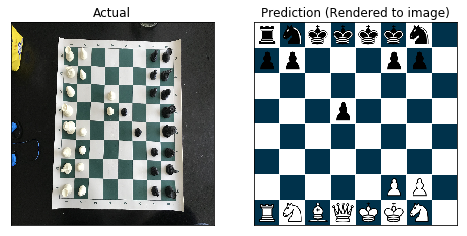

68: Training loss: 0.42040616273880005
68: Training accuracy: 0.6953125
Epoch 69

------------------------------------------------------------
Batch Number: 138
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqkbn1-pRp2p2-1p6-2p5-8-8-n7-1NBBQQ1R
Example Accuracy: 0.625


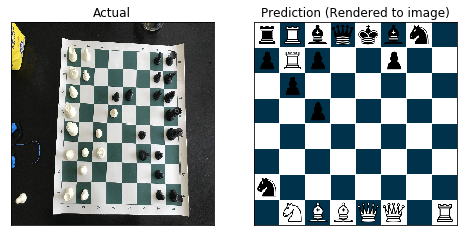

69: Training loss: 0.42164772748947144
69: Training accuracy: 0.684374988079071
Epoch 70

------------------------------------------------------------
Batch Number: 140
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rRRRR2r-p1p2ppr-6p1-1P4p1-1PpP4-1P6-nPP2P2-1NBBKBNq
Example Accuracy: 0.65625


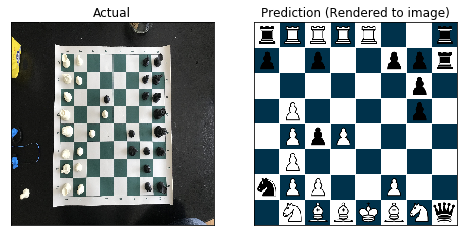

70: Training loss: 0.3835318684577942
70: Training accuracy: 0.7125000357627869
Epoch 71

------------------------------------------------------------
Batch Number: 142
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: Rnbqbbn1-1pp2p1r-8-3p4-8-8-1P2PPB1-1NBQK2R
Example Accuracy: 0.78125


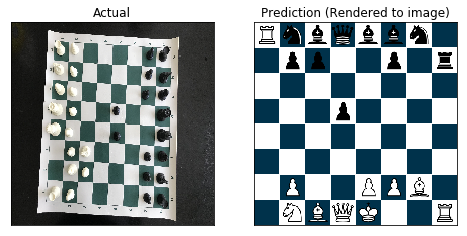

71: Training loss: 0.3975768983364105
71: Training accuracy: 0.7015625238418579
Epoch 72

------------------------------------------------------------
Batch Number: 144
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rRRRR2r-pppppppr-1p3Np1-6p1-2pP4-8-PP3P2-RNBKKBNq
Example Accuracy: 0.71875


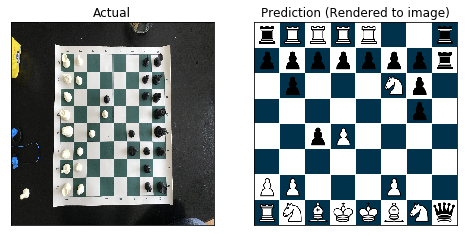

72: Training loss: 0.41502007842063904
72: Training accuracy: 0.6890625357627869
Epoch 73

------------------------------------------------------------
Batch Number: 146
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnqqb3-p4p2-8-8-8-8-4PP2-RNBBQQNn
Example Accuracy: 0.671875


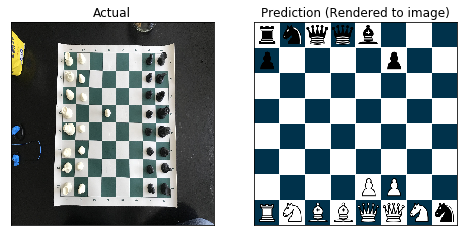

73: Training loss: 0.42378440499305725
73: Training accuracy: 0.682812511920929
Epoch 74

------------------------------------------------------------
Batch Number: 148
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: R1qkkbnr-R4ppr-7r-1P1p2Pr-1P6-2P3P1-5P1P-p1NB3R
Example Accuracy: 0.578125


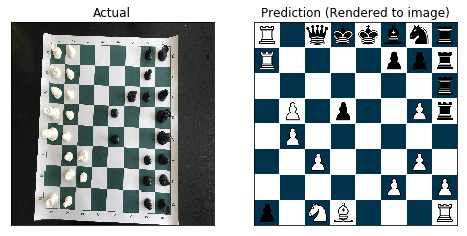

74: Training loss: 0.4247457981109619
74: Training accuracy: 0.6703125238418579
Epoch 75

------------------------------------------------------------
Batch Number: 150
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqkbb1-pRpp1p2-3pNn2-2p5-2p1p3-3p4-P7-1NBBBQQR
Example Accuracy: 0.609375


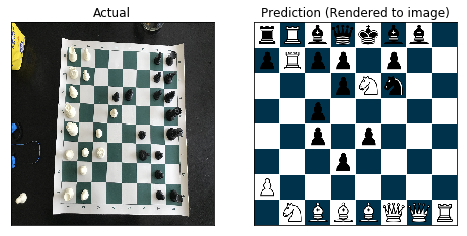

75: Training loss: 0.36699825525283813
75: Training accuracy: 0.731249988079071
Epoch 76

------------------------------------------------------------
Batch Number: 152
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqbbn1-2p4r-8-3p4-8-8-5P2-1NBQK2R
Example Accuracy: 0.71875


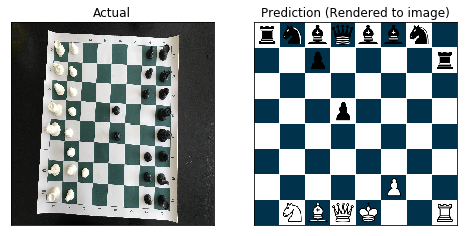

76: Training loss: 0.4172385632991791
76: Training accuracy: 0.6875
Epoch 77

------------------------------------------------------------
Batch Number: 154
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: R1bbbbnr-R4ppr-7r-3p4-8-2P5-5P2-p1NB3R
Example Accuracy: 0.609375


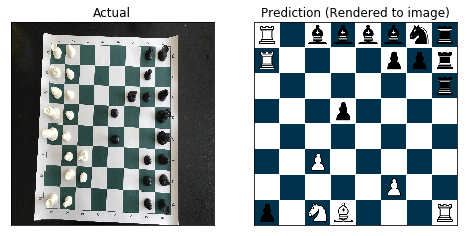

77: Training loss: 0.35934704542160034
77: Training accuracy: 0.7406250238418579
Epoch 78

------------------------------------------------------------
Batch Number: 156
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbbkbnr-pPP2ppr-1P4p1-1P1pp1p1-2Pp4-1P6-R1P2PP1-RNBQQBNr
Example Accuracy: 0.703125


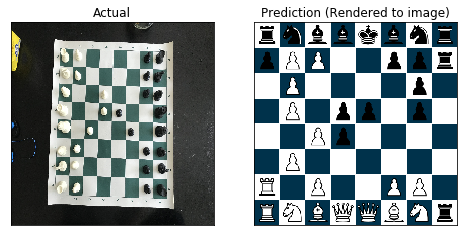

78: Training loss: 0.3845188021659851
78: Training accuracy: 0.714062511920929
Epoch 79

------------------------------------------------------------
Batch Number: 158
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: R1bbbbnr-5P1r-2n5-8-8-8-1P1P1P2-RNNBBNNR
Example Accuracy: 0.640625


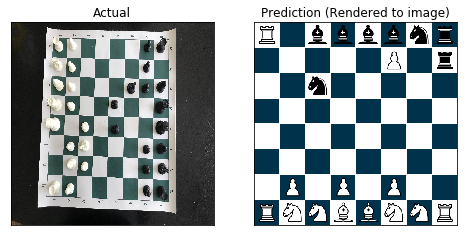

79: Training loss: 0.3587571978569031
79: Training accuracy: 0.7171875238418579
Epoch 80

------------------------------------------------------------
Batch Number: 160
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rRRRr3-p5pr-8-8-2p5-8-P7-1NQQQBNR
Example Accuracy: 0.671875


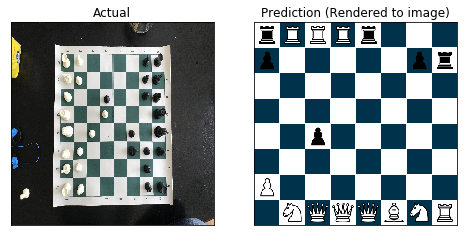

80: Training loss: 0.3684856593608856
80: Training accuracy: 0.7203125357627869
Epoch 81

------------------------------------------------------------
Batch Number: 162
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: r1qbkbnr-R4ppr-7r-3p4-8-2P5-5P2-p1NQK2R
Example Accuracy: 0.65625


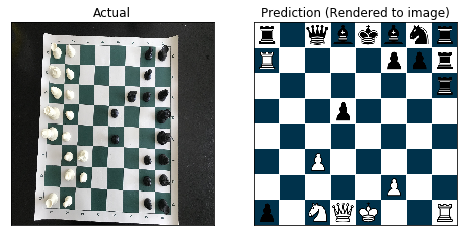

81: Training loss: 0.3414533734321594
81: Training accuracy: 0.7640625238418579
Epoch 82

------------------------------------------------------------
Batch Number: 164
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR
Guess: rnRRN2r-pPpppp1n-2P5-RP6-8-2p5-R1PPPP2-RNBKKBNR
Example Accuracy: 0.734375


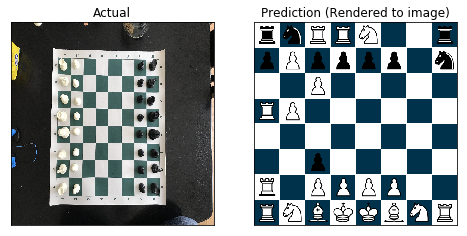

82: Training loss: 0.34070760011672974
82: Training accuracy: 0.7562500238418579
Epoch 83

------------------------------------------------------------
Batch Number: 166
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: Rnbqkbnr-1pp2ppr-8-3p4-8-6P1-1PP1PPB1-1NBQK1pR
Example Accuracy: 0.859375


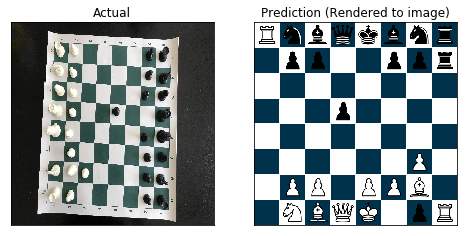

83: Training loss: 0.3197050988674164
83: Training accuracy: 0.746874988079071
Epoch 84

------------------------------------------------------------
Batch Number: 168
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqb1nr-ppp1pppr-8-8-6B1-8-R3PPP1-RNBBKBNR
Example Accuracy: 0.828125


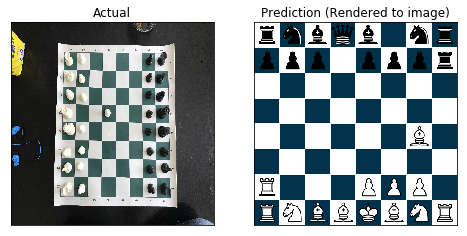

84: Training loss: 0.30107221007347107
84: Training accuracy: 0.78125
Epoch 85

------------------------------------------------------------
Batch Number: 170
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-1pp2ppr-7r-3pp3-8-5NP1-1PP1PPB1-1NBQK1pR
Example Accuracy: 0.828125


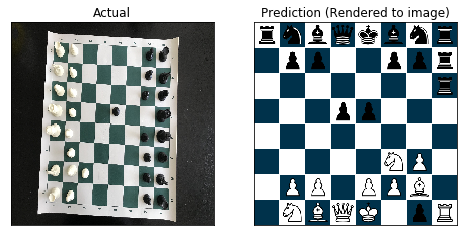

85: Training loss: 0.2896820604801178
85: Training accuracy: 0.8031250238418579
Epoch 86

------------------------------------------------------------
Batch Number: 172
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: r1bkkbnr-R4ppr-7r-3p4-8-2P3P1-5P2-2NQK2R
Example Accuracy: 0.6875


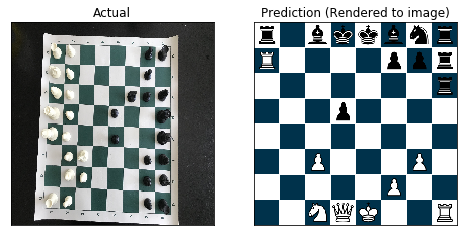

86: Training loss: 0.30902618169784546
86: Training accuracy: 0.768750011920929
Epoch 87

------------------------------------------------------------
Batch Number: 174
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rRRRr2r-pppppp1r-2p5-3p4-2P5-8-5P2-RNBQQBNR
Example Accuracy: 0.734375


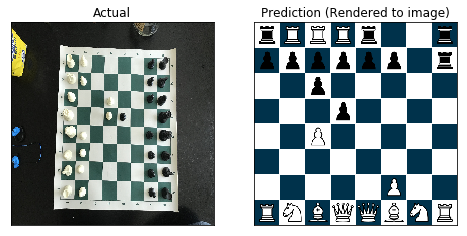

87: Training loss: 0.3117694854736328
87: Training accuracy: 0.7734375
Epoch 88

------------------------------------------------------------
Batch Number: 176
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-1pp2ppr-7r-3pp3-8-5NP1-1PPpPPB1-1NBQK1NR
Example Accuracy: 0.84375


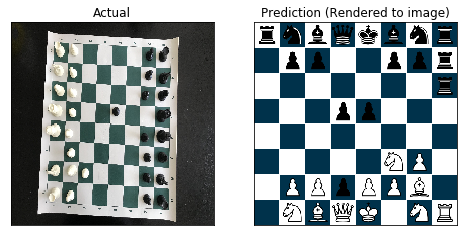

88: Training loss: 0.3129257559776306
88: Training accuracy: 0.7750000357627869
Epoch 89

------------------------------------------------------------
Batch Number: 178
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqb1n1-p1p1ppp1-8-8-8-8-R1P1PPP1-RNBQKKNR
Example Accuracy: 0.828125


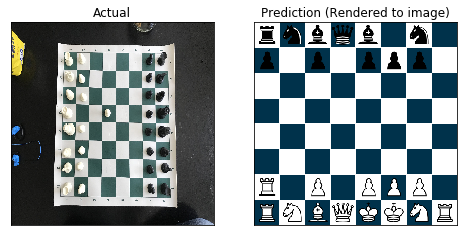

89: Training loss: 0.2707176208496094
89: Training accuracy: 0.785937488079071
Epoch 90

------------------------------------------------------------
Batch Number: 180
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: Rnbqkbn1-Ppp2ppr-8-3p4-8-6P1-1PPPPPB1-PNBQK2R
Example Accuracy: 0.859375


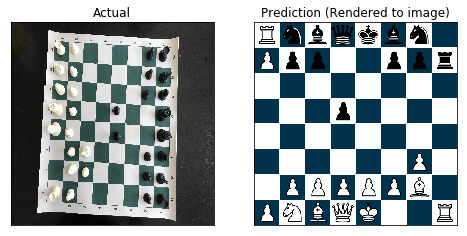

90: Training loss: 0.28058505058288574
90: Training accuracy: 0.796875
Epoch 91

------------------------------------------------------------
Batch Number: 182
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbbkbnr-ppppppp1-8-3pP1P1-8-8-RPp2PP1-RNBBKBNR
Example Accuracy: 0.78125


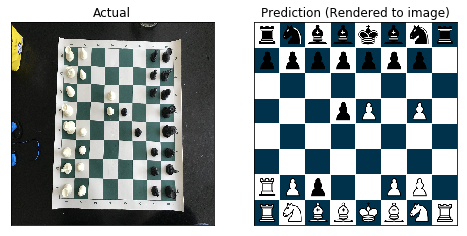

91: Training loss: 0.2716750204563141
91: Training accuracy: 0.8046875
Epoch 92

------------------------------------------------------------
Batch Number: 184
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rRRqk2r-p1p3pr-5n2-8-2p5-8-P4P2-1NBQKBNR
Example Accuracy: 0.796875


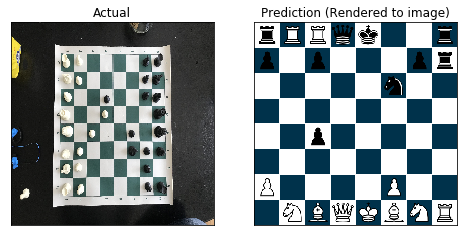

92: Training loss: 0.29392361640930176
92: Training accuracy: 0.784375011920929
Epoch 93

------------------------------------------------------------
Batch Number: 186
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqkbb1-ppp2p2-5n2-8-8-5N2-PP3PP1-RNBQQQ1R
Example Accuracy: 0.78125


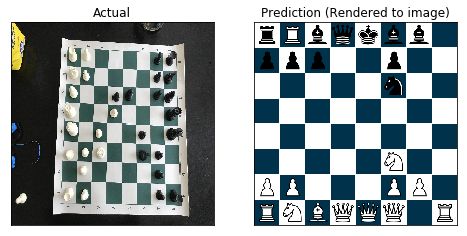

93: Training loss: 0.24871258437633514
93: Training accuracy: 0.809374988079071
Epoch 94

------------------------------------------------------------
Batch Number: 188
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rRRRRb1r-pppppppr-2p5-3pPP2-2PP4-1p6-1P3P2-RNBKKBNR
Example Accuracy: 0.75


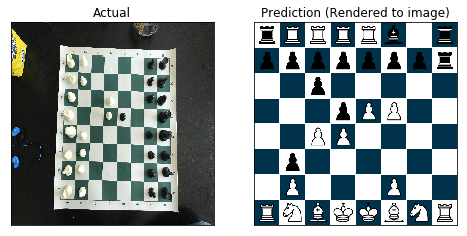

94: Training loss: 0.254690557718277
94: Training accuracy: 0.8203125
Epoch 95

------------------------------------------------------------
Batch Number: 190
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRkqkb2-ppp2p2-3ppn2-8-2p5-5N2-P4PP1-RNBBBB1R
Example Accuracy: 0.78125


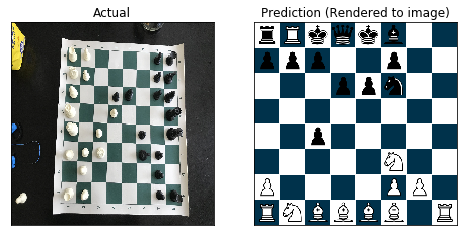

95: Training loss: 0.24615678191184998
95: Training accuracy: 0.817187488079071
Epoch 96

------------------------------------------------------------
Batch Number: 192
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: rnbqkbn1-Rpp2ppr-8-3pp3-8-8-1P3PB1-RNBBK2R
Example Accuracy: 0.828125


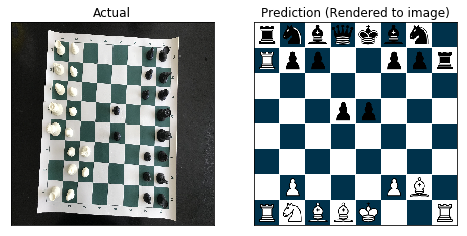

96: Training loss: 0.24863676726818085
96: Training accuracy: 0.809374988079071
Epoch 97

------------------------------------------------------------
Batch Number: 194
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-1pp2ppr-7r-3p4-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.90625


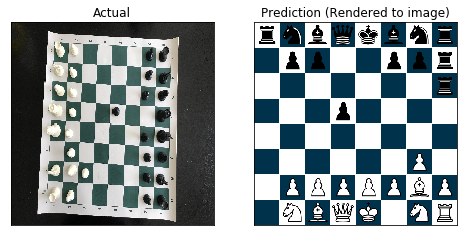

97: Training loss: 0.23155419528484344
97: Training accuracy: 0.846875011920929
Epoch 98

------------------------------------------------------------
Batch Number: 196
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR
Guess: rnqqkbnr-pPP2ppr-8-3p4-2PP4-8-1P3PP1-PNBQQBNr
Example Accuracy: 0.828125


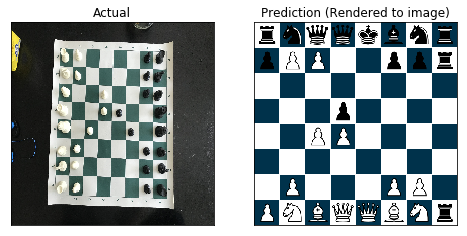

98: Training loss: 0.22088439762592316
98: Training accuracy: 0.8609375357627869
Epoch 99

------------------------------------------------------------
Batch Number: 198
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnkbkbn1-ppp1ppp1-8-8-8-8-4PPP1-rNBQQQNR
Example Accuracy: 0.796875


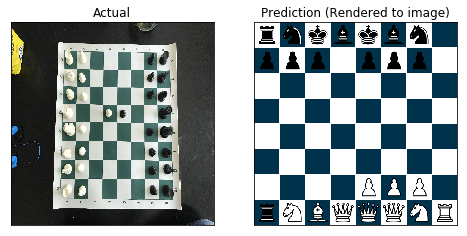

99: Training loss: 0.2455013543367386
99: Training accuracy: 0.8109375238418579
Epoch 100

------------------------------------------------------------
Batch Number: 200
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: rnbqkbnr-Rpp2ppr-7p-3pp3-1pp5-4p1P1-RPPpPPBP-RNBQK2R
Example Accuracy: 0.859375


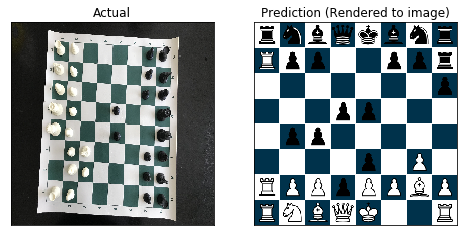

100: Training loss: 0.23400571942329407
100: Training accuracy: 0.831250011920929
Epoch 101

------------------------------------------------------------
Batch Number: 202
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-1pp4r-8-3p4-8-6P1-1PPPPPB1-1NBQK1NR
Example Accuracy: 0.875


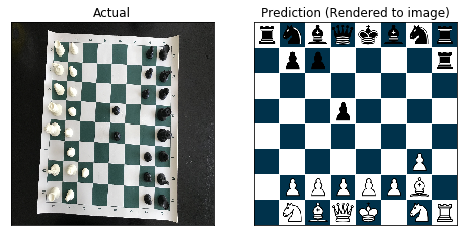

101: Training loss: 0.2428087443113327
101: Training accuracy: 0.824999988079071
Epoch 102

------------------------------------------------------------
Batch Number: 204
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR
Guess: rnqqkbnr-pPP2p1r-8-3p4-2PP4-8-1P3PP1-RNBBBBNR
Example Accuracy: 0.828125


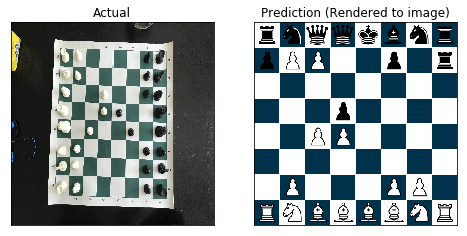

102: Training loss: 0.2145260125398636
102: Training accuracy: 0.846875011920929
Epoch 103

------------------------------------------------------------
Batch Number: 206
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-1pp1pppr-7r-3pp3-8-4pNP1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.875


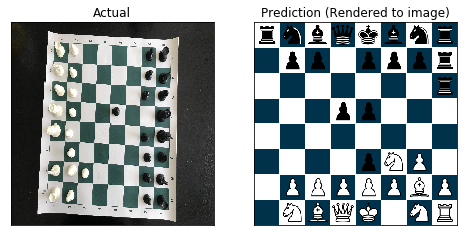

103: Training loss: 0.27198249101638794
103: Training accuracy: 0.7671875357627869
Epoch 104

------------------------------------------------------------
Batch Number: 208
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqk3-pp6-5n2-8-8-5N2-P5P1-RNBQQQ1R
Example Accuracy: 0.75


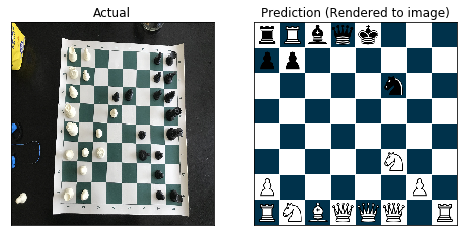

104: Training loss: 0.2606033980846405
104: Training accuracy: 0.792187511920929
Epoch 105

------------------------------------------------------------
Batch Number: 210
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbbkbnr-p2P4-8-3nP1P1-2PP4-1P6-PP1PPPP1-RNBQBBNR
Example Accuracy: 0.765625


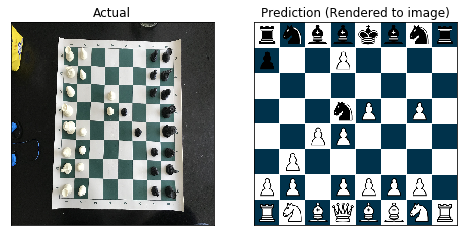

105: Training loss: 0.24961169064044952
105: Training accuracy: 0.8203125
Epoch 106

------------------------------------------------------------
Batch Number: 212
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbbkbnp-pppP1ppp-8-3pP3-2PP4-1P6-PP1PPPP1-pNBQKBNR
Example Accuracy: 0.859375


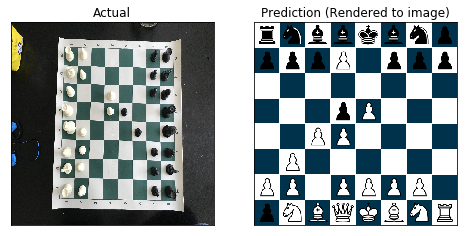

106: Training loss: 0.2061963826417923
106: Training accuracy: 0.8656250238418579
Epoch 107

------------------------------------------------------------
Batch Number: 214
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqkbn1-ppppppp1-2p1p3-3p4-3p4-8-p1p1PP2-pNBKKKNR
Example Accuracy: 0.78125


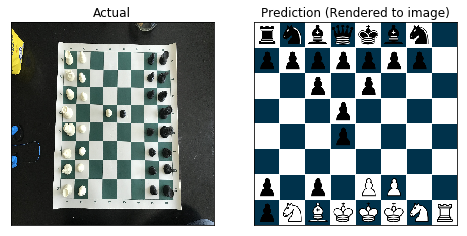

107: Training loss: 0.2451886683702469
107: Training accuracy: 0.801562488079071
Epoch 108

------------------------------------------------------------
Batch Number: 216
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqbbn1-ppppppp1-8-8-8-8-R1P1PPP1-RNBQKKNR
Example Accuracy: 0.875


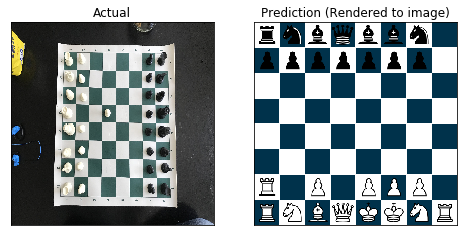

108: Training loss: 0.22688141465187073
108: Training accuracy: 0.823437511920929
Epoch 109

------------------------------------------------------------
Batch Number: 218
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR
Guess: rnqqkbnr-pPP2ppr-P7-P2p2P1-2PP4-4P1P1-PP3PPP-PNBQQBNR
Example Accuracy: 0.828125


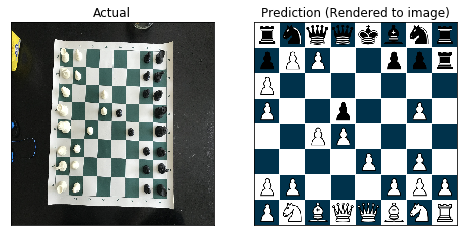

109: Training loss: 0.2259579449892044
109: Training accuracy: 0.8296875357627869
Epoch 110

------------------------------------------------------------
Batch Number: 220
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqkbnr-ppP1pppr-P7-P7-3P4-1P6-RP2PPP1-RNBBBBNR
Example Accuracy: 0.828125


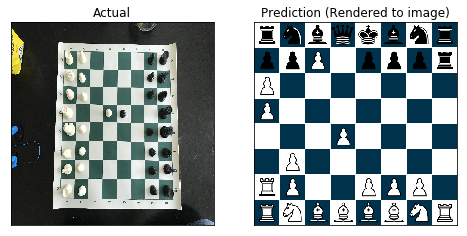

110: Training loss: 0.21863813698291779
110: Training accuracy: 0.8375000357627869
Epoch 111

------------------------------------------------------------
Batch Number: 222
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: r1bqkbnr-1pp2ppr-2n5-4p3-8-5N2-1P1P1PB1-nNBQK2R
Example Accuracy: 0.859375


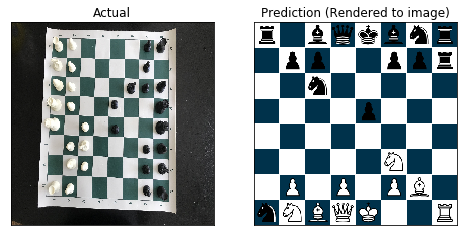

111: Training loss: 0.212030291557312
111: Training accuracy: 0.8265625238418579
Epoch 112

------------------------------------------------------------
Batch Number: 224
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqkbnr-pppppppr-8-8-8-8-RpP1PPP1-RNBQKKNR
Example Accuracy: 0.90625


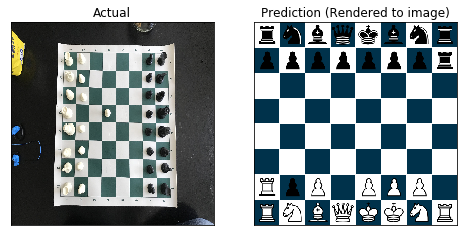

112: Training loss: 0.20318090915679932
112: Training accuracy: 0.8453125357627869
Epoch 113

------------------------------------------------------------
Batch Number: 226
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR
Guess: rnkRk2r-pPpppp1n-8-R7-8-8-R1PPPPpP-RNBQKBNR
Example Accuracy: 0.828125


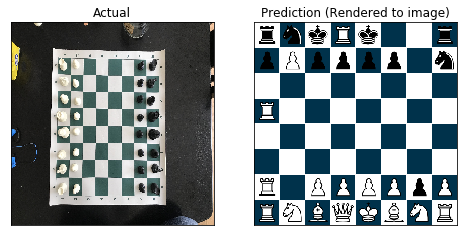

113: Training loss: 0.18522725999355316
113: Training accuracy: 0.8843750357627869
Epoch 114

------------------------------------------------------------
Batch Number: 228
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-1ppP1ppr-7p-3p4-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.890625


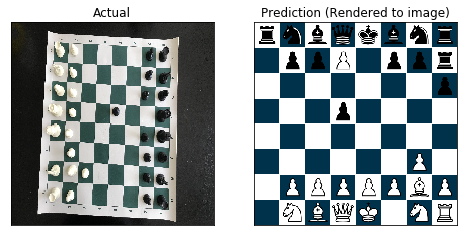

114: Training loss: 0.19733506441116333
114: Training accuracy: 0.870312511920929
Epoch 115

------------------------------------------------------------
Batch Number: 230
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: r1bqkbnr-R4ppr-2n4r-3p4-8-5NP1-PPP2PBP-RNBQK2R
Example Accuracy: 0.875


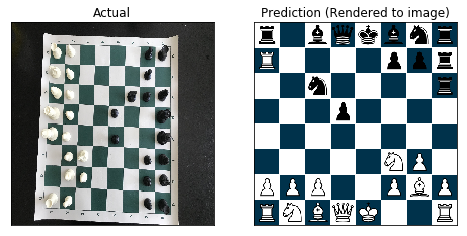

115: Training loss: 0.1899959295988083
115: Training accuracy: 0.871874988079071
Epoch 116

------------------------------------------------------------
Batch Number: 232
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkbn1-ppp2pp1-8-3p4-3P4-8-4PPP1-pNBQKKNR
Example Accuracy: 0.859375


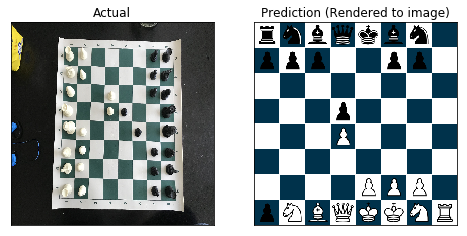

116: Training loss: 0.1597488522529602
116: Training accuracy: 0.8890625238418579
Epoch 117

------------------------------------------------------------
Batch Number: 234
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnkqkbnp-ppppppp1-2p1p3-3p4-3P4-8-pP2PPP1-pNBQKBNR
Example Accuracy: 0.84375


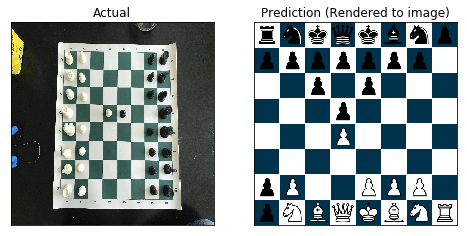

117: Training loss: 0.19530628621578217
117: Training accuracy: 0.846875011920929
Epoch 118

------------------------------------------------------------
Batch Number: 236
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: rnbqkbnr-1pp2ppr-8-3pp3-8-6P1-1PPPPPBP-1NBQK2R
Example Accuracy: 0.921875


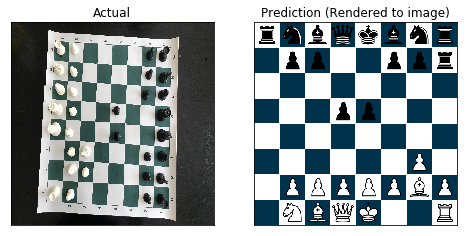

118: Training loss: 0.16542713344097137
118: Training accuracy: 0.890625
Epoch 119

------------------------------------------------------------
Batch Number: 238
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-1pp2p1r-7r-3pp3-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.90625


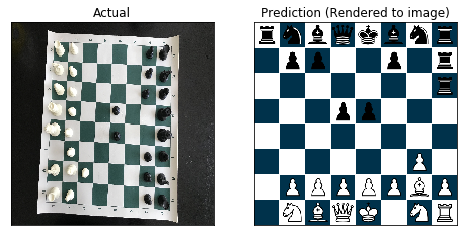

119: Training loss: 0.1629326492547989
119: Training accuracy: 0.885937511920929
Epoch 120

------------------------------------------------------------
Batch Number: 240
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqk2r-pR3p2-4pn1r-8-3P4-4PN2-PP3PPP-RNBQKB1R
Example Accuracy: 0.875


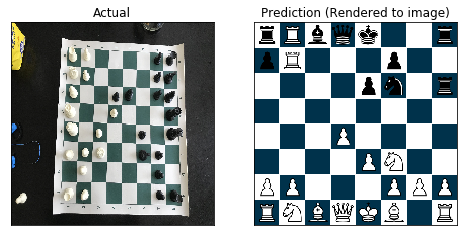

120: Training loss: 0.18259796500205994
120: Training accuracy: 0.864062488079071
Epoch 121

------------------------------------------------------------
Batch Number: 242
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbRkb1r-pppppppr-8-3p4-2PP4-1p6-1p3PP1-RNBQKBNR
Example Accuracy: 0.859375


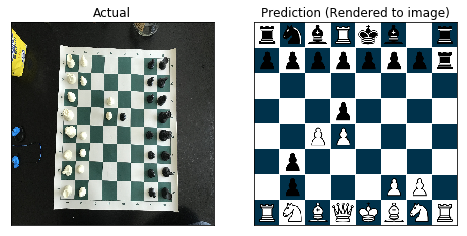

121: Training loss: 0.15241988003253937
121: Training accuracy: 0.901562511920929
Epoch 122

------------------------------------------------------------
Batch Number: 244
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbqkP1r-ppp2ppr-5n2-8-2p5-8-PP3PPP-1NBQKBNR
Example Accuracy: 0.90625


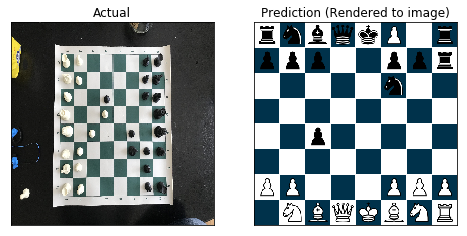

122: Training loss: 0.1492280215024948
122: Training accuracy: 0.9000000357627869
Epoch 123

------------------------------------------------------------
Batch Number: 246
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkbn1-ppp2pp1-8-3p4-2PP4-8-PP2PPP1-PNBQKKNR
Example Accuracy: 0.90625


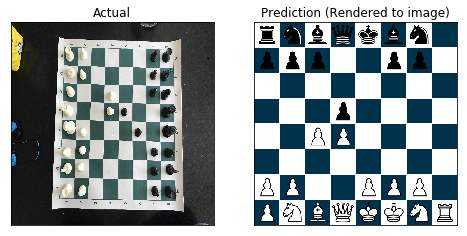

123: Training loss: 0.14020006358623505
123: Training accuracy: 0.9156250357627869
Epoch 124

------------------------------------------------------------
Batch Number: 248
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: R1bqkbnr-Rpp2ppp-2n5-3pp3-4P3-P4N2-PPPP1PBP-RNBQK2R
Example Accuracy: 0.90625


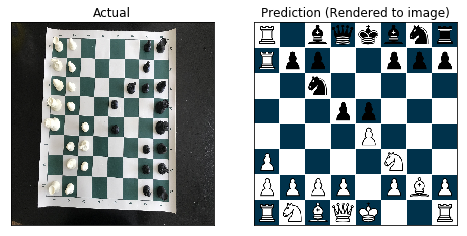

124: Training loss: 0.14748208224773407
124: Training accuracy: 0.909375011920929
Epoch 125

------------------------------------------------------------
Batch Number: 250
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: r1bqkbnr-Ppp2ppp-2n5-3pp3-4P3-4PN2-PPPP1PBP-RNBBK2R
Example Accuracy: 0.9375


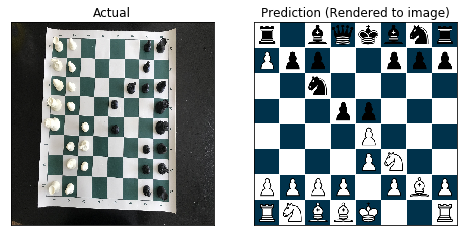

125: Training loss: 0.15201082825660706
125: Training accuracy: 0.909375011920929
Epoch 126

------------------------------------------------------------
Batch Number: 252
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqkbnr-ppp1pppp-R7-R2p4-3P4-8-RPP1PPP1-RNBQKBNR
Example Accuracy: 0.9375


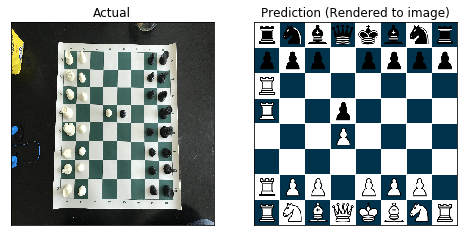

126: Training loss: 0.14017944037914276
126: Training accuracy: 0.9203125238418579
Epoch 127

------------------------------------------------------------
Batch Number: 254
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqk2r-ppp2ppp-4pn1r-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Example Accuracy: 0.96875


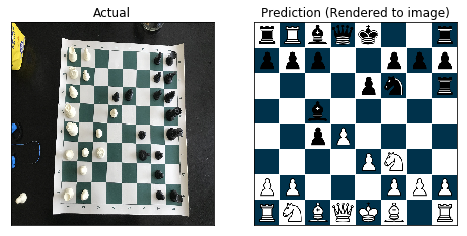

127: Training loss: 0.12768074870109558
127: Training accuracy: 0.918749988079071
Epoch 128

------------------------------------------------------------
Batch Number: 256
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkbn1-ppp2pp1-8-3p4-2PP4-8-1P2PPP1-RNBKKBNR
Example Accuracy: 0.90625


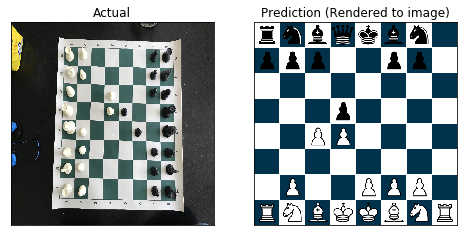

128: Training loss: 0.12013642489910126
128: Training accuracy: 0.918749988079071
Epoch 129

------------------------------------------------------------
Batch Number: 258
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqkbnp-pppppppr-8-8-3PP3-8-RPP1PPP1-RNBBQBNR
Example Accuracy: 0.890625


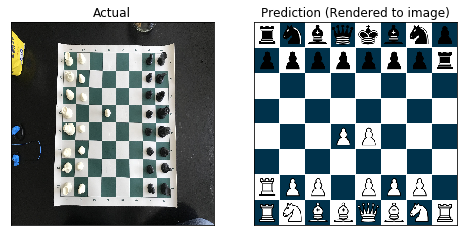

129: Training loss: 0.12319346517324448
129: Training accuracy: 0.9078125357627869
Epoch 130

------------------------------------------------------------
Batch Number: 260
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqkbnr-pppppppr-8-P7-3PP3-8-RPP1PPPP-RNBQQBNR
Example Accuracy: 0.921875


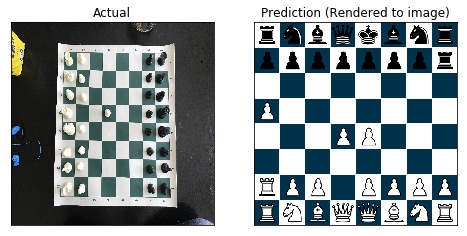

130: Training loss: 0.1322827935218811
130: Training accuracy: 0.9125000238418579
Epoch 131

------------------------------------------------------------
Batch Number: 262
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbqkP1r-p1p2ppp-4pn2-8-2p5-4P3-PP3PPP-PNBQKBNR
Example Accuracy: 0.9375


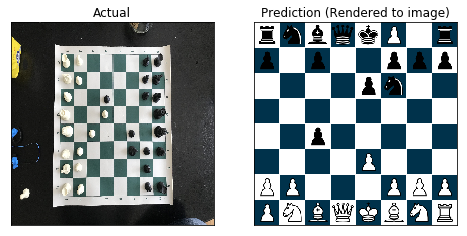

131: Training loss: 0.11709930747747421
131: Training accuracy: 0.9203125238418579
Epoch 132

------------------------------------------------------------
Batch Number: 264
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnp-1pp2ppp-7p-3pp3-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.921875


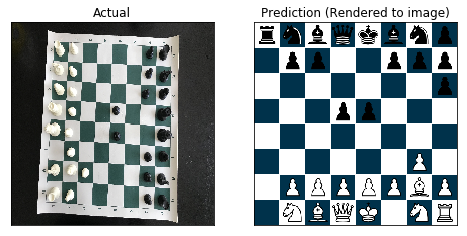

132: Training loss: 0.11725284904241562
132: Training accuracy: 0.9156250357627869
Epoch 133

------------------------------------------------------------
Batch Number: 266
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: r1bqkbnr-Rpp2ppp-2n4p-3pp3-4P3-5NP1-RPPP1PBR-RNBBK2R
Example Accuracy: 0.890625


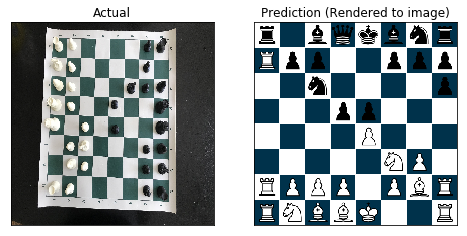

133: Training loss: 0.11323948204517365
133: Training accuracy: 0.9234375357627869
Epoch 134

------------------------------------------------------------
Batch Number: 268
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-Rpp2ppr-7r-3pp3-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.921875


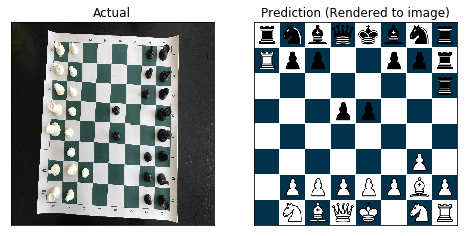

134: Training loss: 0.1117190271615982
134: Training accuracy: 0.9296875
Epoch 135

------------------------------------------------------------
Batch Number: 270
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR
Guess: rnkqkb1r-pPpppp1p-8-R7-8-1P6-RPPPPPPP-RNBQKBNR
Example Accuracy: 0.890625


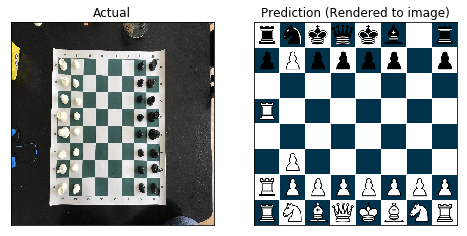

135: Training loss: 0.11111471801996231
135: Training accuracy: 0.9312500357627869
Epoch 136

------------------------------------------------------------
Batch Number: 272
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: rnbqkbn1-1pp2ppp-8-3pp3-8-5NP1-1PPPPPBP-1NBQK2R
Example Accuracy: 0.9375


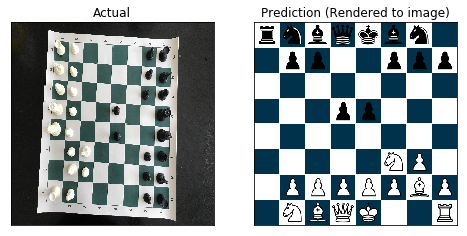

136: Training loss: 0.10853488743305206
136: Training accuracy: 0.9281250238418579
Epoch 137

------------------------------------------------------------
Batch Number: 274
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: r1bqkbnr-ppp2ppp-2n4p-3pp3-3pP3-5NPP-PPPP1PBP-RNBBK2R
Example Accuracy: 0.90625


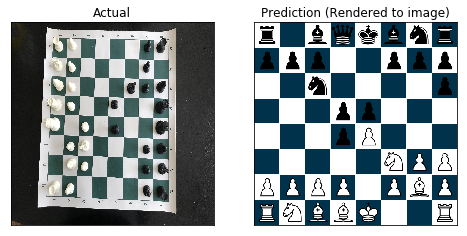

137: Training loss: 0.1143583431839943
137: Training accuracy: 0.926562488079071
Epoch 138

------------------------------------------------------------
Batch Number: 276
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqk3-ppp2pp1-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Example Accuracy: 0.953125


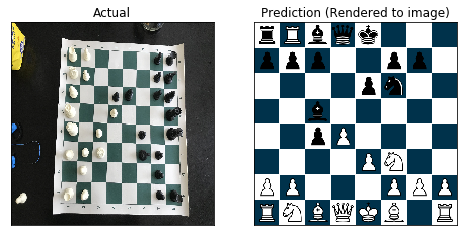

138: Training loss: 0.09386489540338516
138: Training accuracy: 0.942187488079071
Epoch 139

------------------------------------------------------------
Batch Number: 278
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: r1bqkbnr-Rpp2ppp-2n5-8-4P3-P3PNP1-PPPP1PBP-RNBBK2R
Example Accuracy: 0.90625


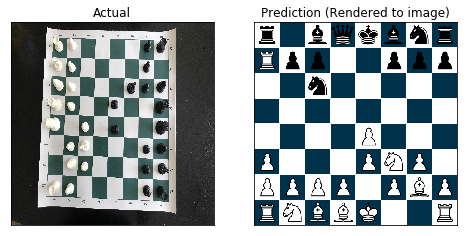

139: Training loss: 0.10688513517379761
139: Training accuracy: 0.9296875
Epoch 140

------------------------------------------------------------
Batch Number: 280
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbqkP1r-ppp2ppr-4pn2-8-1ppP4-4P3-PP3PPP-PNBQKBNR
Example Accuracy: 0.9375


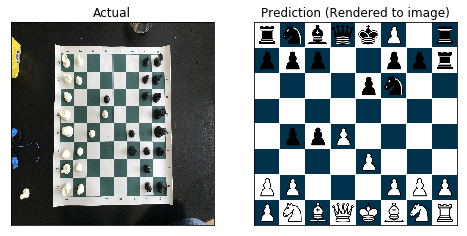

140: Training loss: 0.09431057423353195
140: Training accuracy: 0.9375
Epoch 141

------------------------------------------------------------
Batch Number: 282
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqkbnr-pppppppr-8-8-3P4-8-RPP1PPP1-RNBQKKNR
Example Accuracy: 0.9375


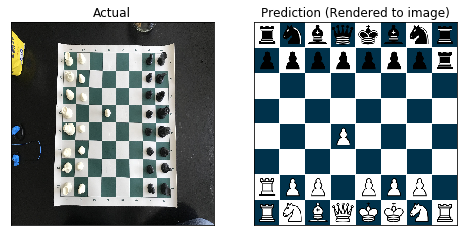

141: Training loss: 0.09780708700418472
141: Training accuracy: 0.9390625357627869
Epoch 142

------------------------------------------------------------
Batch Number: 284
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: rnbqkbn1-ppp2ppp-8-3pp3-8-5NP1-1PPP1PBP-PNBQK2R
Example Accuracy: 0.9375


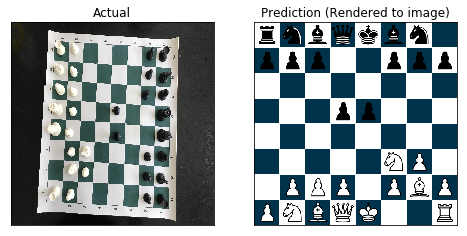

142: Training loss: 0.1006942167878151
142: Training accuracy: 0.926562488079071
Epoch 143

------------------------------------------------------------
Batch Number: 286
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqk3-ppp2pp1-P3pn2-P1b2P2-2pP4-4PN2-PP3PPP-RNBQKB1R
Example Accuracy: 0.90625


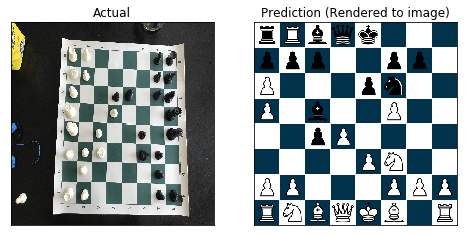

143: Training loss: 0.10887940227985382
143: Training accuracy: 0.9125000238418579
Epoch 144

------------------------------------------------------------
Batch Number: 288
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkbnr-ppp2ppp-8-3p4-2PP4-8-1P2PPP1-RNBQBBNR
Example Accuracy: 0.9375


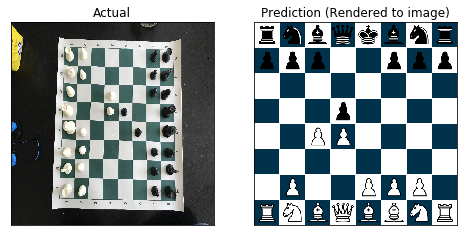

144: Training loss: 0.09125450253486633
144: Training accuracy: 0.940625011920929
Epoch 145

------------------------------------------------------------
Batch Number: 290
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkb1r-ppp1pppr-8-3p4-2PP4-8-1P3PP1-RNBQKBNR
Example Accuracy: 0.921875


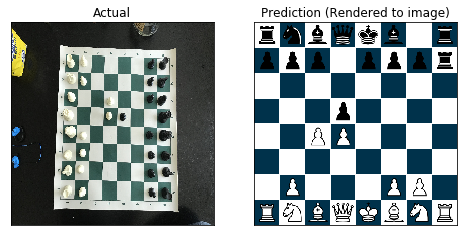

145: Training loss: 0.08930648863315582
145: Training accuracy: 0.9437500238418579
Epoch 146

------------------------------------------------------------
Batch Number: 292
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbqkb1r-ppp2ppp-4pn2-8-1ppP4-3PP3-PP3PPP-RNBKKBNR
Example Accuracy: 0.953125


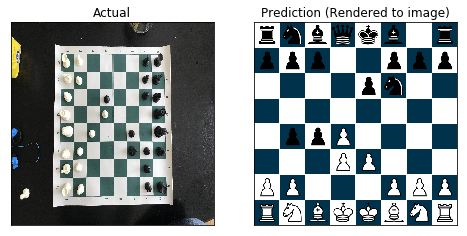

146: Training loss: 0.0935075655579567
146: Training accuracy: 0.9390625357627869
Epoch 147

------------------------------------------------------------
Batch Number: 294
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: r1bqkbnr-ppp2ppr-2n4r-3pp3-8-5NP1-1PPP1PBP-RNBQK2R
Example Accuracy: 0.9375


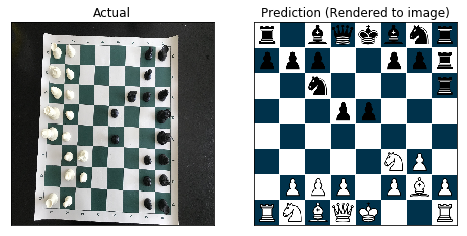

147: Training loss: 0.07864365726709366
147: Training accuracy: 0.948437511920929
Epoch 148

------------------------------------------------------------
Batch Number: 296
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqk2r-ppp2pp1-4pn1r-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Example Accuracy: 0.953125


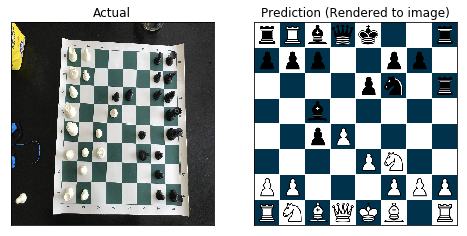

148: Training loss: 0.08040691912174225
148: Training accuracy: 0.9468750357627869
Epoch 149

------------------------------------------------------------
Batch Number: 298
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQQBNR
Example Accuracy: 0.984375


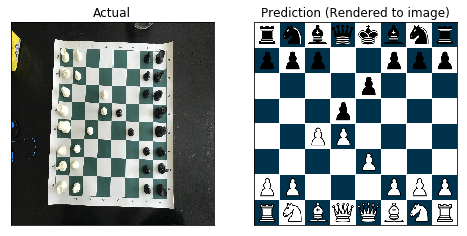

149: Training loss: 0.07089334726333618
149: Training accuracy: 0.956250011920929
Epoch 150

------------------------------------------------------------
Batch Number: 300
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkbn1-ppp2pp1-4p3-3p4-2PP4-8-PP2PPP1-RNBQKBNR
Example Accuracy: 0.953125


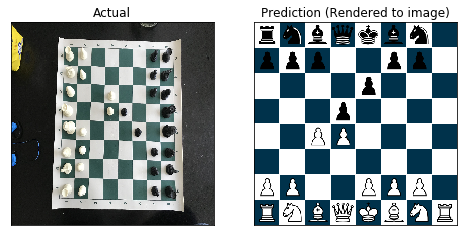

150: Training loss: 0.07572386413812637
150: Training accuracy: 0.953125
Epoch 151

------------------------------------------------------------
Batch Number: 302
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-ppp1pppr-7r-3p4-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.9375


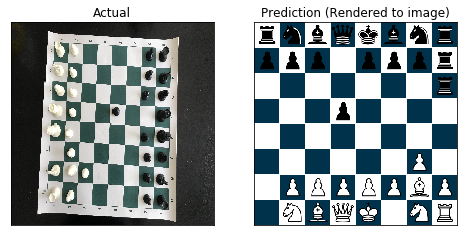

151: Training loss: 0.07099345326423645
151: Training accuracy: 0.956250011920929
Epoch 152

------------------------------------------------------------
Batch Number: 304
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkb1r-ppp1pppr-8-3p4-2PP4-8-1P3PPP-RNBKKBNR
Example Accuracy: 0.921875


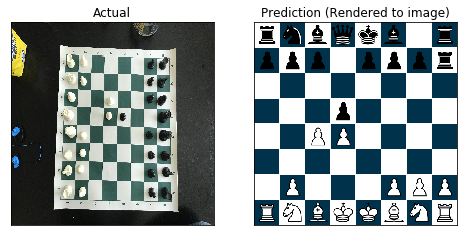

152: Training loss: 0.07342617958784103
152: Training accuracy: 0.9453125
Epoch 153

------------------------------------------------------------
Batch Number: 306
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Example Accuracy: 1.0


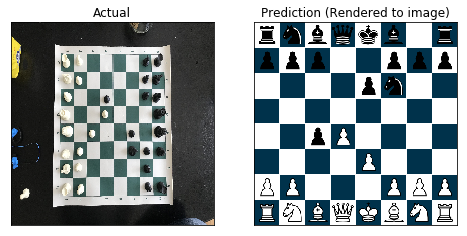

153: Training loss: 0.07014714926481247
153: Training accuracy: 0.9703125357627869
Epoch 154

------------------------------------------------------------
Batch Number: 308
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqk3-ppp2pp1-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Example Accuracy: 0.953125


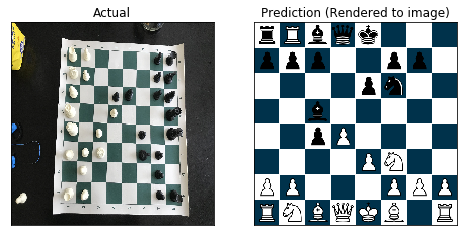

154: Training loss: 0.06619729101657867
154: Training accuracy: 0.953125
Epoch 155

------------------------------------------------------------
Batch Number: 310
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkb1r-ppp1pppr-8-3p4-2PP4-8-4PPPP-RNBQKBNR
Example Accuracy: 0.9375


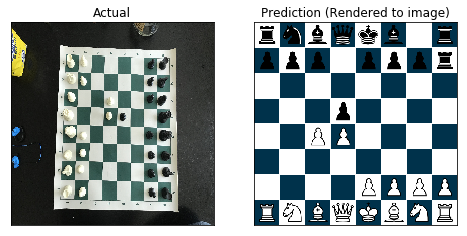

155: Training loss: 0.058253686875104904
155: Training accuracy: 0.9750000238418579
Epoch 156

------------------------------------------------------------
Batch Number: 312
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR
Guess: rnbqkb1r-pppppppp-8-R7-8-8-PPPPPPPP-RNBQKBNR
Example Accuracy: 0.96875


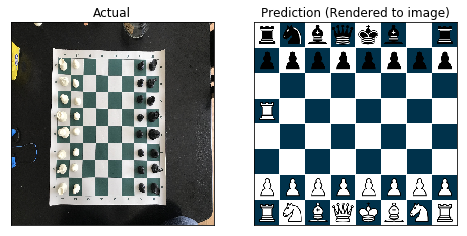

156: Training loss: 0.06913861632347107
156: Training accuracy: 0.9625000357627869
Epoch 157

------------------------------------------------------------
Batch Number: 314
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqk3-ppp2pp1-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Example Accuracy: 0.953125


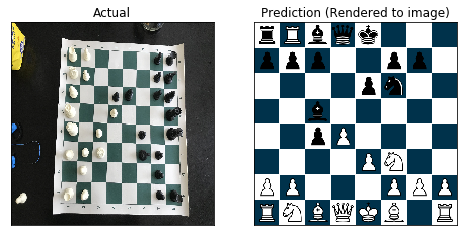

157: Training loss: 0.06437027454376221
157: Training accuracy: 0.9593750238418579
Epoch 158

------------------------------------------------------------
Batch Number: 316
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: r1bqkbnr-ppp2ppp-2n5-3pp3-8-R3PNP1-RPPP1PBP-RNBQK2R
Example Accuracy: 0.96875


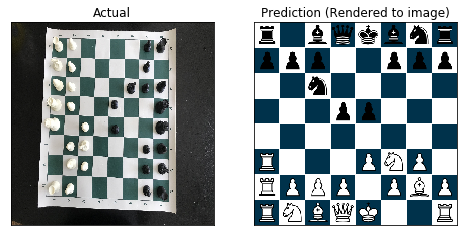

158: Training loss: 0.05931506305932999
158: Training accuracy: 0.964062511920929
Epoch 159

------------------------------------------------------------
Batch Number: 318
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-ppp1pppp-7p-3p4-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.953125


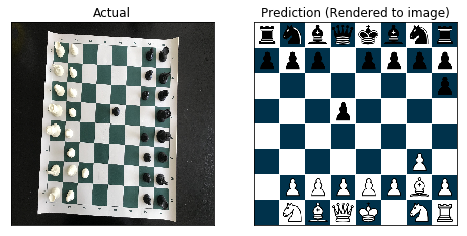

159: Training loss: 0.05638528987765312
159: Training accuracy: 0.973437488079071
Epoch 160

------------------------------------------------------------
Batch Number: 320
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-1pp1pppp-8-3p4-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.953125


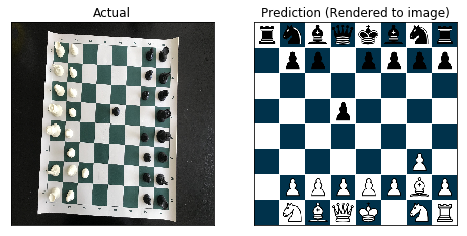

160: Training loss: 0.05411683768033981
160: Training accuracy: 0.965624988079071
Epoch 161

------------------------------------------------------------
Batch Number: 322
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBKKBNR
Example Accuracy: 0.984375


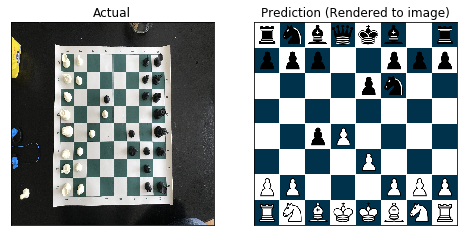

161: Training loss: 0.055702127516269684
161: Training accuracy: 0.9703125357627869
Epoch 162

------------------------------------------------------------
Batch Number: 324
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: r1bqkbnr-ppp2ppp-2n4r-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Example Accuracy: 0.984375


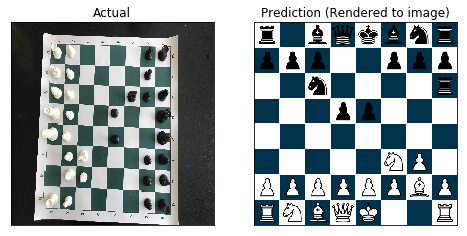

162: Training loss: 0.057041287422180176
162: Training accuracy: 0.9703125357627869
Epoch 163

------------------------------------------------------------
Batch Number: 326
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqkbnr-ppp1pppp-8-3p4-3P4-8-RPP1PPPP-RNBQKBNR
Example Accuracy: 0.984375


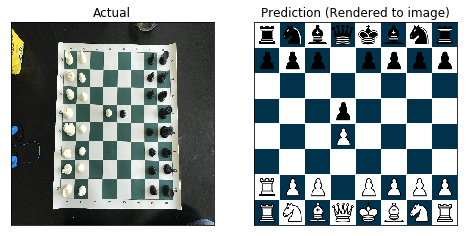

163: Training loss: 0.05231533199548721
163: Training accuracy: 0.971875011920929
Epoch 164

------------------------------------------------------------
Batch Number: 328
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: r1bqkbnr-ppp2ppp-2n4r-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Example Accuracy: 0.984375


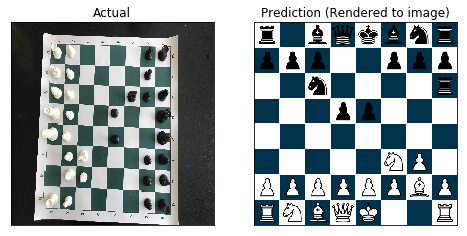

164: Training loss: 0.04977136105298996
164: Training accuracy: 0.9765625
Epoch 165

------------------------------------------------------------
Batch Number: 330
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkb1r-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBKKBNR
Example Accuracy: 0.96875


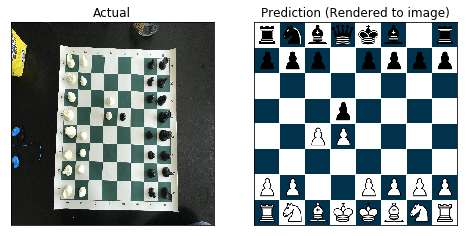

165: Training loss: 0.05263052508234978
165: Training accuracy: 0.9703125357627869
Epoch 166

------------------------------------------------------------
Batch Number: 332
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-1PPPPPBP-RNBQK2R
Example Accuracy: 0.984375


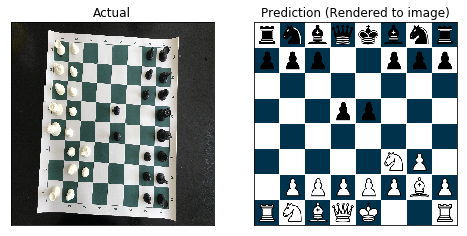

166: Training loss: 0.04979701340198517
166: Training accuracy: 0.9703125357627869
Epoch 167

------------------------------------------------------------
Batch Number: 334
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-PNBQQBNR
Example Accuracy: 0.96875


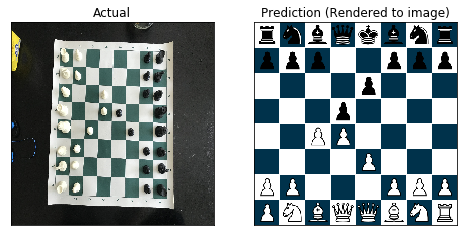

167: Training loss: 0.05220974609255791
167: Training accuracy: 0.9671875238418579
Epoch 168

------------------------------------------------------------
Batch Number: 336
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqkbnr-ppp1pppp-R7-P2p4-3P4-8-RPP1PPPP-RNBQKBNR
Example Accuracy: 0.953125


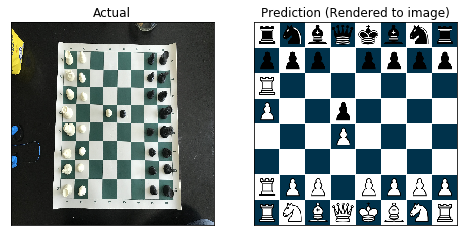

168: Training loss: 0.04810705780982971
168: Training accuracy: 0.9750000238418579
Epoch 169

------------------------------------------------------------
Batch Number: 338
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: r1bqkbnr-ppp2ppr-2n4r-3pp3-8-5NP1-1PPP1PBP-RNBQK2R
Example Accuracy: 0.9375


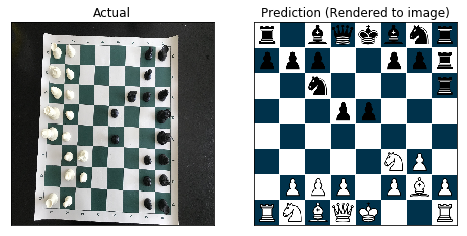

169: Training loss: 0.04696882516145706
169: Training accuracy: 0.973437488079071
Epoch 170

------------------------------------------------------------
Batch Number: 340
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rPbqk2r-ppp2ppp-4pn1r-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Example Accuracy: 0.96875


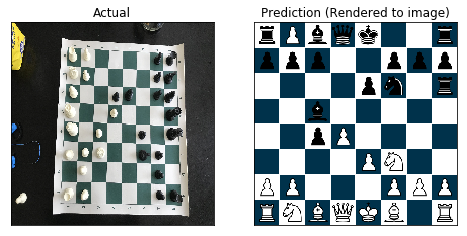

170: Training loss: 0.05119771882891655
170: Training accuracy: 0.9703125357627869
Epoch 171

------------------------------------------------------------
Batch Number: 342
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-PNBQKBNR
Example Accuracy: 0.984375


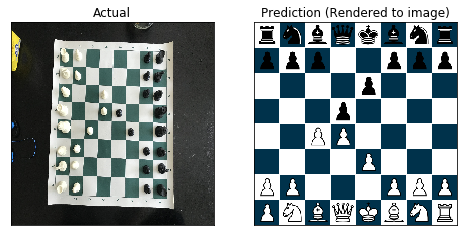

171: Training loss: 0.04595313221216202
171: Training accuracy: 0.973437488079071
Epoch 172

------------------------------------------------------------
Batch Number: 344
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.96875


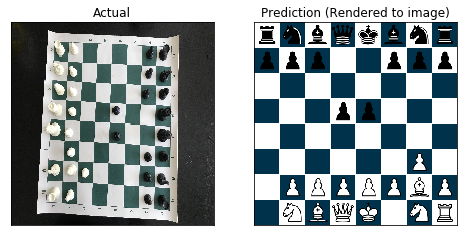

172: Training loss: 0.04871998354792595
172: Training accuracy: 0.971875011920929
Epoch 173

------------------------------------------------------------
Batch Number: 346
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Example Accuracy: 1.0


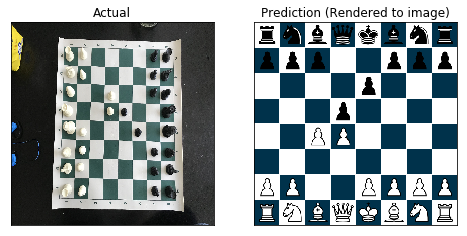

173: Training loss: 0.04906053468585014
173: Training accuracy: 0.971875011920929
Epoch 174

------------------------------------------------------------
Batch Number: 348
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-1PPPPPBP-1NBQK2R
Example Accuracy: 0.96875


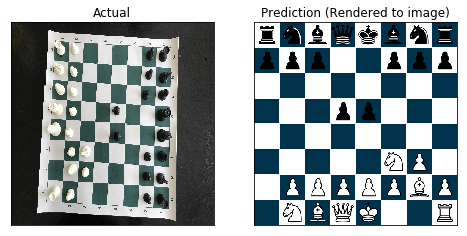

174: Training loss: 0.0516030415892601
174: Training accuracy: 0.9671875238418579
Epoch 175

------------------------------------------------------------
Batch Number: 350
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: rnbqkbnr-ppp2ppp-8-3pp3-8-P4NP1-PPPPPPBP-PNBQK2R
Example Accuracy: 0.96875


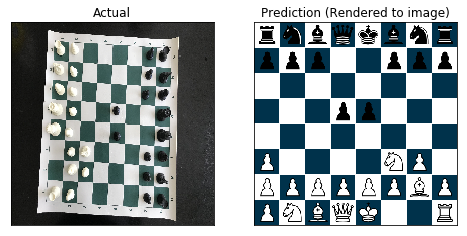

175: Training loss: 0.052348267287015915
175: Training accuracy: 0.964062511920929
Epoch 176

------------------------------------------------------------
Batch Number: 352
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-RPPP1PBP-RNBQK2R
Example Accuracy: 0.984375


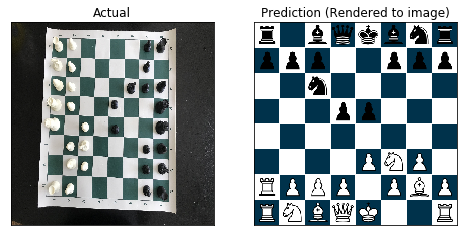

176: Training loss: 0.0499875433743
176: Training accuracy: 0.96875
Epoch 177

------------------------------------------------------------
Batch Number: 354
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbqkbnr-ppp2ppp-1P2p3-3p4-2PP4-3PP3-PP3PPP-RNBQQBNR
Example Accuracy: 0.953125


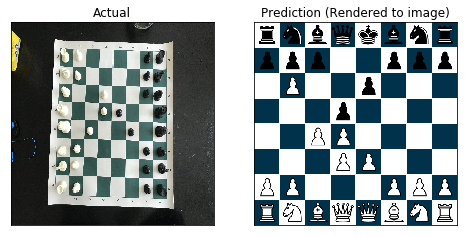

177: Training loss: 0.05739554017782211
177: Training accuracy: 0.953125
Epoch 178

------------------------------------------------------------
Batch Number: 356
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.96875


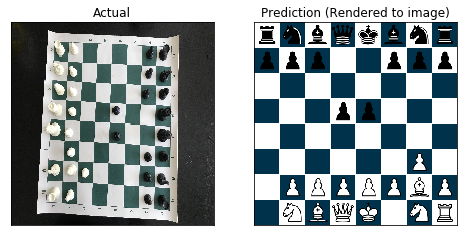

178: Training loss: 0.04251059889793396
178: Training accuracy: 0.96875
Epoch 179

------------------------------------------------------------
Batch Number: 358
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Example Accuracy: 1.0


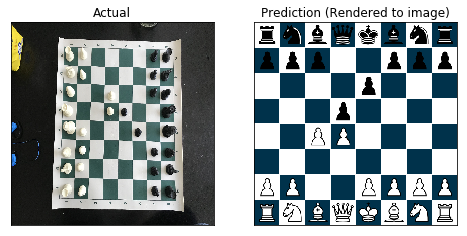

179: Training loss: 0.04883984103798866
179: Training accuracy: 0.9671875238418579
Epoch 180

------------------------------------------------------------
Batch Number: 360
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: r1bqkbnr-ppp2ppr-2n4r-3pp3-8-5NP1-1PPP1PBP-RNBQK2R
Example Accuracy: 0.9375


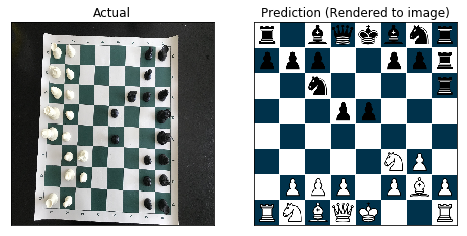

180: Training loss: 0.053209882229566574
180: Training accuracy: 0.9593750238418579
Epoch 181

------------------------------------------------------------
Batch Number: 362
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.96875


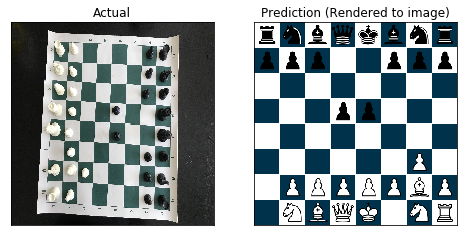

181: Training loss: 0.040409330278635025
181: Training accuracy: 0.9781250357627869
Epoch 182

------------------------------------------------------------
Batch Number: 364
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqkbnp-pppppppp-8-R7-3PP3-8-RPP1PPPP-RNBQKBNR
Example Accuracy: 0.9375


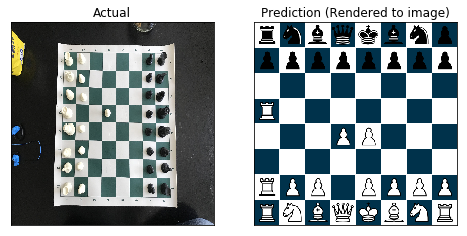

182: Training loss: 0.05302538722753525
182: Training accuracy: 0.956250011920929
Epoch 183

------------------------------------------------------------
Batch Number: 366
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkb1r-ppp1pppp-8-3p4-2PP4-8-1P2PPPP-RNBQKBNR
Example Accuracy: 0.96875


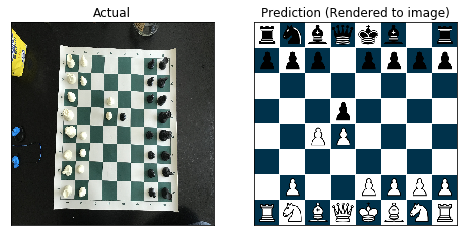

183: Training loss: 0.04260268807411194
183: Training accuracy: 0.973437488079071
Epoch 184

------------------------------------------------------------
Batch Number: 368
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-ppp2ppr-7r-3pp3-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.9375


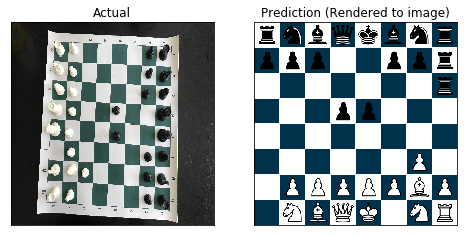

184: Training loss: 0.046837322413921356
184: Training accuracy: 0.965624988079071
Epoch 185

------------------------------------------------------------
Batch Number: 370
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-ppp1pppp-7p-3p4-8-6P1-PPPPPPBP-PNBQK1NR
Example Accuracy: 0.96875


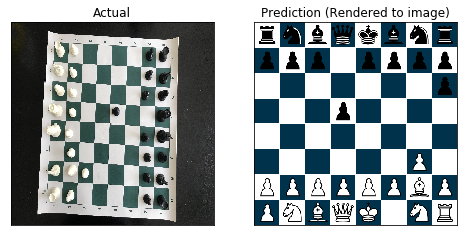

185: Training loss: 0.039185136556625366
185: Training accuracy: 0.971875011920929
Epoch 186

------------------------------------------------------------
Batch Number: 372
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: r1bqkbnp-ppp2ppp-2n5-3pp3-8-R3PNP1-RPPP1PBP-RNBQK2R
Example Accuracy: 0.953125


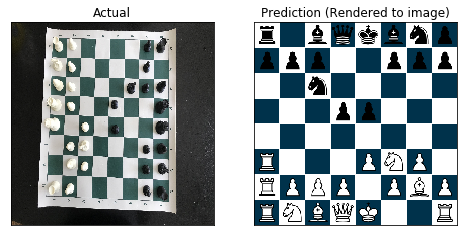

186: Training loss: 0.04622847959399223
186: Training accuracy: 0.9593750238418579
Epoch 187

------------------------------------------------------------
Batch Number: 374
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Example Accuracy: 1.0


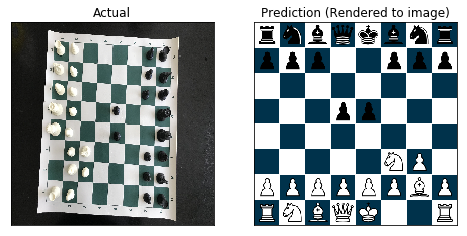

187: Training loss: 0.03191958740353584
187: Training accuracy: 0.987500011920929
Epoch 188

------------------------------------------------------------
Batch Number: 376
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-1pp2ppp-8-3pp3-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.953125


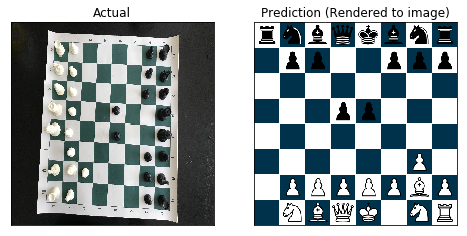

188: Training loss: 0.03662039339542389
188: Training accuracy: 0.973437488079071
Epoch 189

------------------------------------------------------------
Batch Number: 378
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Example Accuracy: 1.0


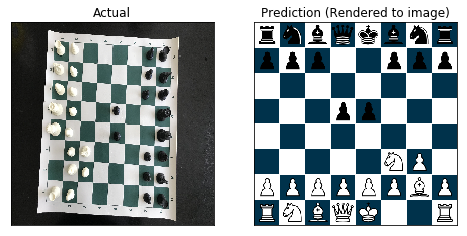

189: Training loss: 0.0331762358546257
189: Training accuracy: 0.984375
Epoch 190

------------------------------------------------------------
Batch Number: 380
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rRbqk2r-ppp2pp1-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Example Accuracy: 0.96875


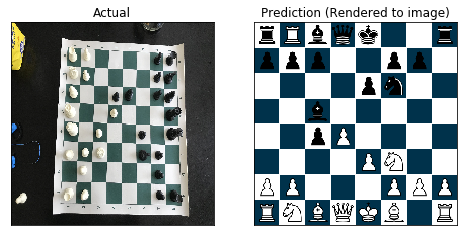

190: Training loss: 0.03543902933597565
190: Training accuracy: 0.979687511920929
Epoch 191

------------------------------------------------------------
Batch Number: 382
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-PNBQKBNR
Example Accuracy: 0.984375


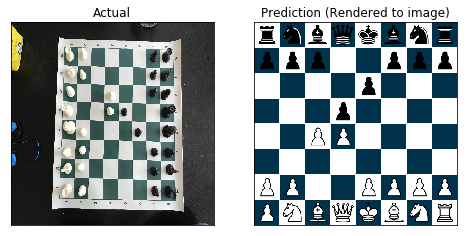

191: Training loss: 0.03373849764466286
191: Training accuracy: 0.981249988079071
Epoch 192

------------------------------------------------------------
Batch Number: 384
Example training point:
Actual: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkbnr-ppp2ppp-4p3-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Example Accuracy: 1.0


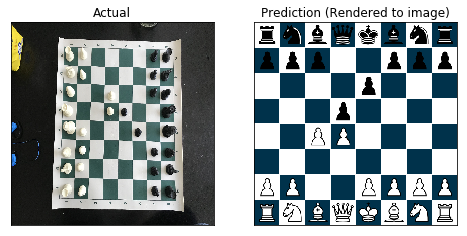

192: Training loss: 0.031005706638097763
192: Training accuracy: 0.989062488079071
Epoch 193

------------------------------------------------------------
Batch Number: 386
Example training point:
Actual: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Guess: rnbqk2r-ppp2ppp-4pn2-2b5-2pP4-4PN2-PP3PPP-RNBQKB1R
Example Accuracy: 1.0


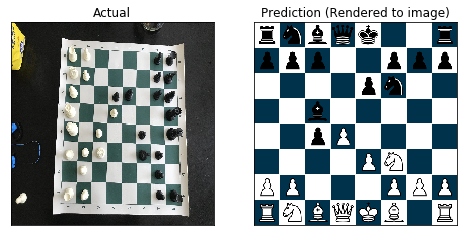

193: Training loss: 0.03259546682238579
193: Training accuracy: 0.9859375357627869
Epoch 194

------------------------------------------------------------
Batch Number: 388
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-3P4-8-PPP1PPPP-RNBQKBNR
Guess: rnbqkbnr-pppppppp-8-8-3PP3-8-RPP1PPPP-RNBQKBNR
Example Accuracy: 0.96875


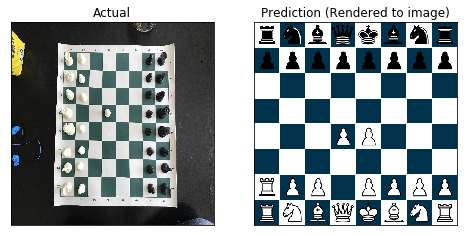

194: Training loss: 0.03196101263165474
194: Training accuracy: 0.981249988079071
Epoch 195

------------------------------------------------------------
Batch Number: 390
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Guess: rnbqkb1r-ppp1pppp-8-3p4-2PP4-8-PP2PPPP-RNBQKBNR
Example Accuracy: 0.984375


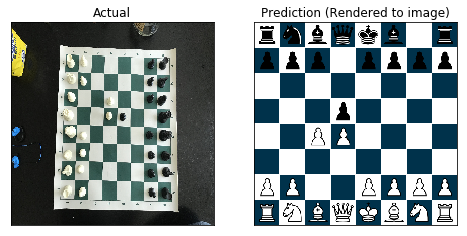

195: Training loss: 0.028986206278204918
195: Training accuracy: 0.9859375357627869
Epoch 196

------------------------------------------------------------
Batch Number: 392
Example training point:
Actual: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Guess: r1bqkbnr-ppp2ppp-2n5-3pp3-8-4PNP1-PPPP1PBP-RNBQK2R
Example Accuracy: 1.0


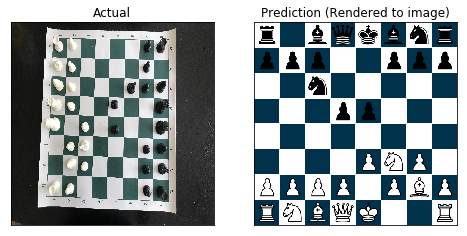

196: Training loss: 0.030444737523794174
196: Training accuracy: 0.979687511920929
Epoch 197

------------------------------------------------------------
Batch Number: 394
Example training point:
Actual: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-ppp1pppp-8-3p4-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.96875


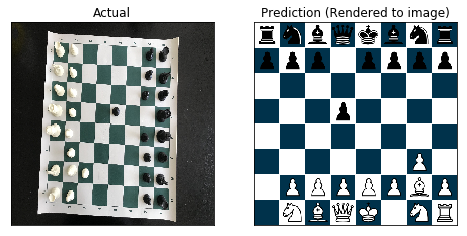

197: Training loss: 0.028409874066710472
197: Training accuracy: 0.9859375357627869
Epoch 198

------------------------------------------------------------
Batch Number: 396
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-PPPPPPBP-RNBQK1NR
Guess: rnbqkbnr-ppp2ppp-8-3pp3-8-6P1-1PPPPPBP-1NBQK1NR
Example Accuracy: 0.96875


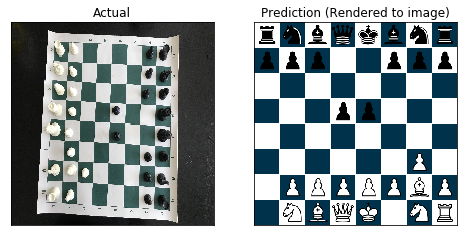

198: Training loss: 0.02698473259806633
198: Training accuracy: 0.989062488079071
Epoch 199

------------------------------------------------------------
Batch Number: 398
Example training point:
Actual: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Guess: rnbqkb1r-ppp2ppp-4pn2-8-2pP4-4P3-PP3PPP-RNBQKBNR
Example Accuracy: 1.0


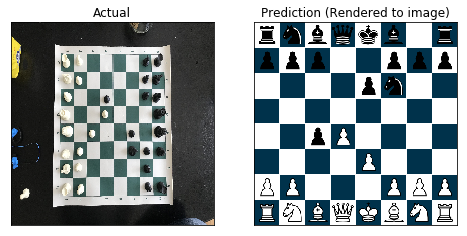

199: Training loss: 0.027524057775735855
199: Training accuracy: 0.9859375357627869
Epoch 200

------------------------------------------------------------
Batch Number: 400
Example training point:
Actual: rnbqkbnr-pppppppp-8-8-8-8-PPPPPPPP-RNBQKBNR
Guess: rnbqkb1r-pppppp1p-8-R7-8-8-PPPPPPPP-RNBQKBNR
Example Accuracy: 0.953125


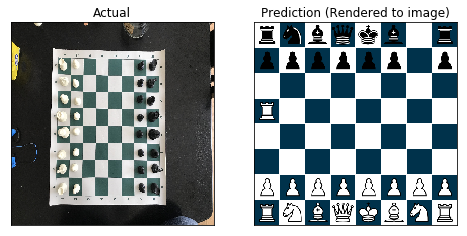

200: Training loss: 0.02548379823565483
200: Training accuracy: 0.981249988079071
Epoch 201

------------------------------------------------------------
Batch Number: 402
Example training point:
Actual: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-RNBQK2R
Guess: rnbqkbnr-ppp2ppp-8-3pp3-8-5NP1-PPPPPPBP-PNBQK2R
Example Accuracy: 0.984375


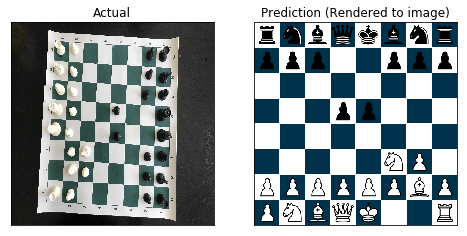

201: Training loss: 0.0248764269053936
201: Training accuracy: 0.9906250238418579
Epoch 202


In [0]:
num_epochs = 500
log_freq=20


learning_rate = 0.0003
# BiggerCNN_No_Dropout, .0005 seems to be best so far
# for cnn in [BiggerCNN_No_Dropout, BiggerCNN]:
#     for learning_rate in [.0005, .0003, .0001]:
learning_rate = .001
cnn = BiggerCNN
net = cnn(batch_size=BATCH_SIZE)

# print a summary of the net statistics
#         summary(net.to(device), (BATCH_SIZE*32, 3, 25, 25))

optimizer = optim.Adam(net.parameters(), lr=learning_rate)

log_dir = f'./logs/{net.name}_lr{learning_rate}'
criterion = nn.CrossEntropyLoss().to(device)



#     images, labels, original_imgs = next(iter(train_loader))
#     y = net.to(device)(Variable(images.to(device)))
#     make_dot(y)
# Run the model
model = train_model(net,
                log_dir,
                train_loader,
                criterion,
                optimizer,
                num_epochs, 
                log_freq,
#                         print_guess=False) # or print_guess=true for pics
                print_guess=True) # or print_guess=False for tqdm

del(model) # just in case :/
del(criterion)
del(optimizer)

        # final_acc = test_model(model, criterion, test_loader) # TODO